# Extracting zip file for train_images

In [ ]:
import zipfile
import os

def extract_zip(file_path: str, extract_to: str):
    """
    Extracts a ZIP file to a specified directory.

    :param file_path: Path to the ZIP file.
    :param extract_to: Directory where the contents should be extracted.
    """
    with zipfile.ZipFile(file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Example usage
file_path = '../Data/archive.zip'
extract_to = '../Data/train_images'
extract_zip(file_path, extract_to)

In [ ]:
pip install pyarrow


   ---------------------------------------- 0.0/25.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/25.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/25.9 MB 217.9 kB/s eta 0:01:59
   ---------------------------------------- 0.0/25.9 MB 217.9 kB/s eta 0:01:59
   ---------------------------------------- 0.1/25.9 MB 292.6 kB/s eta 0:01:29
   ---------------------------------------- 0.1/25.9 MB 454.0 kB/s eta 0:00:57
   ---------------------------------------- 0.2/25.9 MB 778.2 kB/s eta 0:00:34
   ---------------------------------------- 0.3/25.9 MB 930.9 kB/s eta 0:00:28
    --------------------------------------- 0.4/25.9 MB 1.2 MB/s eta 0:00:22
    --------------------------------------- 0.5/25.9 MB 1.2 MB/s eta 0:00:21
    --------------------------------------- 0.6/25.9 MB 1.4 MB/s eta 0:00:19
   - -------------------------------------- 0.8/25.9 MB 1.7 MB/s eta 0:00:15
   - -------------------------------------- 1.2/25.9 MB 2.2 MB/s eta 0:00:12
 

In [ ]:
pip install fastparquet


   ---------------------------------------- 0.0/671.0 kB ? eta -:--:--
   -- ------------------------------------ 41.0/671.0 kB 991.0 kB/s eta 0:00:01
   -------------- ------------------------- 235.5/671.0 kB 2.9 MB/s eta 0:00:01
   --------------------------- ------------ 460.8/671.0 kB 3.6 MB/s eta 0:00:01
   ---------------------------------------- 671.0/671.0 kB 3.8 MB/s eta 0:00:00
   ---------------------------------------- 0.0/1.6 MB ? eta -:--:--
   ------- -------------------------------- 0.3/1.6 MB 9.6 MB/s eta 0:00:01
   ----------------- ---------------------- 0.7/1.6 MB 8.9 MB/s eta 0:00:01
   ------------------------- -------------- 1.0/1.6 MB 8.3 MB/s eta 0:00:01
   ------------------------------------- -- 1.5/1.6 MB 8.9 MB/s eta 0:00:01
   ---------------------------------------- 1.6/1.6 MB 8.0 MB/s eta 0:00:00
   ---------------------------------------- 0.0/176.9 kB ? eta -:--:--
   --------- ------------------------------ 41.0/176.9 kB ? eta -:--:--
   --------------

In [ ]:
pip install pydicom

   ---------------------------------------- 0.0/1.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.8 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.8 MB ? eta -:--:--
   - -------------------------------------- 0.1/1.8 MB 991.0 kB/s eta 0:00:02
   ------- -------------------------------- 0.3/1.8 MB 3.1 MB/s eta 0:00:01
   ----------------- ---------------------- 0.8/1.8 MB 4.3 MB/s eta 0:00:01
   ------------------------ --------------- 1.1/1.8 MB 5.4 MB/s eta 0:00:01
   --------------------------------- ------ 1.5/1.8 MB 5.6 MB/s eta 0:00:01
   ---------------------------------------- 1.8/1.8 MB 5.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip install imageio



  Using cached imageio-2.34.1-py3-none-any.whl.metadata (4.9 kB)
Using cached imageio-2.34.1-py3-none-any.whl (313 kB)


In [ ]:
pip install pillow


Note: you may need to restart the kernel to use updated packages.


In [14]:
pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip install SimpleITK

# EDA

In [2]:
import numpy as np
import pandas as pd
import os
import cv2
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML, display
import ipywidgets as widgets
import seaborn as sns
from glob import glob
import SimpleITK as sitk

import warnings
warnings.simplefilter("ignore")

In [99]:
# Get the current working directory
base_dir = os.getcwd()
base_dir

'e:\\MS_AI_ML\\Dissertation\\Project\\Scripts'

In [100]:
# Load the datasets
train_df = pd.read_csv("../Data/train.csv")
series_meta_df = pd.read_csv('../Data/train_series_meta.csv')
image_labels_df = pd.read_csv('../Data/image_level_labels.csv')

In [101]:
# Display the first few rows of each dataset
print("First few rows of train.csv:")
print(train_df.head(), '\n')

First few rows of train.csv:
   patient_id  bowel_healthy  bowel_injury  extravasation_healthy  \
0       10004              1             0                      0   
1       10005              1             0                      1   
2       10007              1             0                      1   
3       10026              1             0                      1   
4       10051              1             0                      1   

   extravasation_injury  kidney_healthy  kidney_low  kidney_high  \
0                     1               0           1            0   
1                     0               1           0            0   
2                     0               1           0            0   
3                     0               1           0            0   
4                     0               1           0            0   

   liver_healthy  liver_low  liver_high  spleen_healthy  spleen_low  \
0              1          0           0               0           0   
1    

In [102]:
print("First few rows of train_series_meta.csv:")
print(series_meta_df.head(), '\n')

First few rows of train_series_meta.csv:
   patient_id  series_id  aortic_hu  incomplete_organ
0       10004      21057     146.00                 0
1       10004      51033     454.75                 0
2       10005      18667     187.00                 0
3       10007      47578     329.00                 0
4       10026      29700     327.00                 0 



In [103]:
print("First few rows of image_level_labels.csv:")
print(image_labels_df.head(), '\n')

First few rows of image_level_labels.csv:
   patient_id  series_id  instance_number           injury_name
0       10004      21057              362  Active_Extravasation
1       10004      21057              363  Active_Extravasation
2       10004      21057              364  Active_Extravasation
3       10004      21057              365  Active_Extravasation
4       10004      21057              366  Active_Extravasation 



In [104]:
# Check for missing values and their proportion in each dataset
print("Missing values in train.csv:")
print(train_df.isnull().sum())
print(train_df.isnull().mean(), '\n')

Missing values in train.csv:
patient_id               0
bowel_healthy            0
bowel_injury             0
extravasation_healthy    0
extravasation_injury     0
kidney_healthy           0
kidney_low               0
kidney_high              0
liver_healthy            0
liver_low                0
liver_high               0
spleen_healthy           0
spleen_low               0
spleen_high              0
any_injury               0
dtype: int64
patient_id               0.0
bowel_healthy            0.0
bowel_injury             0.0
extravasation_healthy    0.0
extravasation_injury     0.0
kidney_healthy           0.0
kidney_low               0.0
kidney_high              0.0
liver_healthy            0.0
liver_low                0.0
liver_high               0.0
spleen_healthy           0.0
spleen_low               0.0
spleen_high              0.0
any_injury               0.0
dtype: float64 



In [105]:

print("Missing values in train_series_meta.csv:")
print(series_meta_df.isnull().sum())
print(series_meta_df.isnull().mean(), '\n')

Missing values in train_series_meta.csv:
patient_id          0
series_id           0
aortic_hu           0
incomplete_organ    0
dtype: int64
patient_id          0.0
series_id           0.0
aortic_hu           0.0
incomplete_organ    0.0
dtype: float64 



In [106]:
print("Missing values in image_level_labels.csv:")
print(image_labels_df.isnull().sum())
print(image_labels_df.isnull().mean(), '\n')

Missing values in image_level_labels.csv:
patient_id         0
series_id          0
instance_number    0
injury_name        0
dtype: int64
patient_id         0.0
series_id          0.0
instance_number    0.0
injury_name        0.0
dtype: float64 



In [107]:
# Get summary statistics for numerical columns
print("Summary statistics for train.csv:")
print(train_df.describe(), '\n')

Summary statistics for train.csv:
         patient_id  bowel_healthy  bowel_injury  extravasation_healthy  \
count   3147.000000    3147.000000   3147.000000            3147.000000   
mean   32664.239593       0.979663      0.020337               0.936447   
std    18792.043458       0.141172      0.141172               0.243993   
min       19.000000       0.000000      0.000000               0.000000   
25%    16355.500000       1.000000      0.000000               1.000000   
50%    32195.000000       1.000000      0.000000               1.000000   
75%    49302.500000       1.000000      0.000000               1.000000   
max    65508.000000       1.000000      1.000000               1.000000   

       extravasation_injury  kidney_healthy   kidney_low  kidney_high  \
count           3147.000000     3147.000000  3147.000000  3147.000000   
mean               0.063553        0.942167     0.036543     0.021290   
std                0.243993        0.233464     0.187666     0.144373  

In [108]:
print("Summary statistics for train_series_meta.csv:")
print(series_meta_df.describe(), '\n')

Summary statistics for train_series_meta.csv:
         patient_id     series_id    aortic_hu  incomplete_organ
count   4711.000000   4711.000000  4711.000000       4711.000000
mean   32722.826788  32661.752494   223.622373          0.066440
std    18745.299924  18800.490133   103.767762          0.249077
min       19.000000      3.000000 -1024.000000          0.000000
25%    16436.000000  16298.500000   147.000000          0.000000
50%    32235.000000  32387.000000   194.000000          0.000000
75%    49267.500000  48861.500000   280.000000          0.000000
max    65508.000000  65535.000000  1411.000000          1.000000 



In [109]:
print("Summary statistics for image_level_labels.csv:")
print(image_labels_df.describe(), '\n')

Summary statistics for image_level_labels.csv:
         patient_id     series_id  instance_number
count  12029.000000  12029.000000     12029.000000
mean   34909.677862  31188.356056       311.704132
std    19532.614584  19532.946255       210.025487
min       33.000000    242.000000        11.000000
25%    15876.000000  14738.000000       130.000000
50%    36289.000000  28751.000000       252.000000
75%    53908.000000  49108.000000       456.000000
max    65456.000000  65514.000000      1065.000000 



In [110]:

print("Categorical variables in train_series_meta.csv:")
print(series_meta_df.describe(include=['object', 'category']), '\n')

print("Categorical variables in image_level_labels.csv:")
print(image_labels_df.describe(include=['object', 'category']), '\n')

Categorical variables in train_series_meta.csv:


ValueError: No objects to concatenate

In [ ]:


# Exploring relationships between variables
# Pairwise relationships for numerical variables in train.csv
sns.pairplot(train_df.select_dtypes(include=['float64', 'int64']))
plt.show()

# # Correlation matrix
# corr_matrix = train_df.corr()
# sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
# plt.title('Correlation Matrix for train.csv')
# plt.show()



# Distribution analysis for numerical features
for col in numerical_cols:
    plt.figure(figsize=(10, 5))
    sns.histplot(train_df[col], bins=30, kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

# Distribution analysis for categorical features
categorical_cols = train_df.select_dtypes(include=['object', 'category']).columns
for col in categorical_cols:
    plt.figure(figsize=(10, 5))
    sns.countplot(data=train_df, x=col)
    plt.title(f'Distribution of {col}')
    plt.show()

# Groupby and aggregation to understand relationships
# Example: Average aortic_hu by incomplete_organ
agg_df = series_meta_df.groupby('incomplete_organ')['aortic_hu'].mean().reset_index()
print("Average aortic_hu by incomplete_organ:")
print(agg_df)

sns.barplot(data=agg_df, x='incomplete_organ', y='aortic_hu')
plt.title('Average Aortic HU by Incomplete Organ')
plt.show()


## 1. train.csv

In [111]:
train_df = pd.read_csv("../Data/train.csv")
train_df.head()

,patient_id,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10005,1,0,1,0,1,0,0,1,0,0,1,0,0,0
2,10007,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10026,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10051,1,0,1,0,1,0,0,1,0,0,0,1,0,1


In [112]:
# train_df['bowel'] = train_df[['bowel_healthy', 'bowel_injury']] .idxmax(axis=1)
# train_df['extravasation'] = train_df[['extravasation_healthy', 'extravasation_injury']] .idxmax(axis=1)
# train_df['kidney'] = train_df[['kidney_healthy', 'kidney_low','kidney_high']] .idxmax(axis=1)
# train_df['liver'] = train_df[['liver_healthy', 'liver_low','liver_high']] .idxmax(axis=1)
# train_df['spleen'] = train_df[['spleen_healthy', 'spleen_low','spleen_high']] .idxmax(axis=1)

# col = ['bowel_healthy','bowel_injury','extravasation_healthy','extravasation_injury','kidney_healthy',
#        'kidney_low','kidney_high','liver_healthy','liver_low','liver_high','spleen_healthy','spleen_low','spleen_high']

# train_df = train_df.drop(columns =col)

# train_df.head()

In [113]:
train_df['patient_id'].nunique()

3147

In [114]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3147 entries, 0 to 3146
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype
---  ------                 --------------  -----
 0   patient_id             3147 non-null   int64
 1   bowel_healthy          3147 non-null   int64
 2   bowel_injury           3147 non-null   int64
 3   extravasation_healthy  3147 non-null   int64
 4   extravasation_injury   3147 non-null   int64
 5   kidney_healthy         3147 non-null   int64
 6   kidney_low             3147 non-null   int64
 7   kidney_high            3147 non-null   int64
 8   liver_healthy          3147 non-null   int64
 9   liver_low              3147 non-null   int64
 10  liver_high             3147 non-null   int64
 11  spleen_healthy         3147 non-null   int64
 12  spleen_low             3147 non-null   int64
 13  spleen_high            3147 non-null   int64
 14  any_injury             3147 non-null   int64
dtypes: int64(15)
memory usage: 368.9 KB


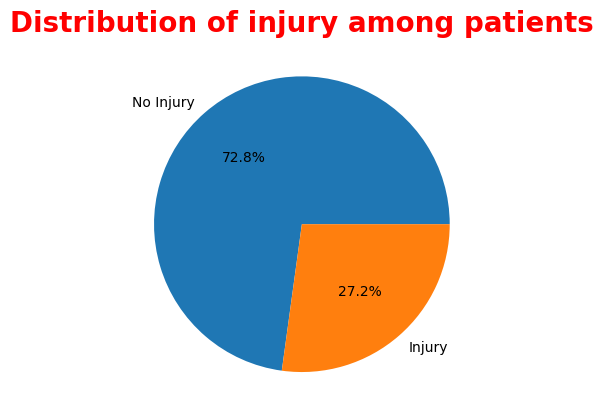

In [66]:
plt.pie(train_df['any_injury'].value_counts(), labels=['No Injury', 'Injury'], autopct='%1.1f%%')
plt.title('Distribution of injury among patients',fontsize=20,color='red', fontweight='bold')  
plt.show()


In [67]:
# train_df['bowel'] = train_df['bowel'].replace(['bowel_injury','bowel_healthy'], [0, 1])
# train_df['extravasation'] = train_df['extravasation'].replace(['extravasation_injury', 'extravasation_healthy'], [0, 1])
# train_df['kidney'] = train_df['kidney'].replace(['kidney_low','kidney_high','kidney_healthy'], [-1,0, 1])
# train_df['liver'] = train_df['liver'].replace(['liver_low','liver_high','liver_healthy'], [-1,0, 1])
# train_df['spleen'] = train_df['spleen'].replace(['spleen_low','spleen_high','spleen_healthy'], [-1,0,1])
# train_df.head()

In [115]:
# Save the updated DataFrame to a CSV file
train_df.to_csv("../Data/updated_train.csv", index=False)

print("Updated DataFrame saved to 'updated_train.csv'")

Updated DataFrame saved to 'updated_train.csv'


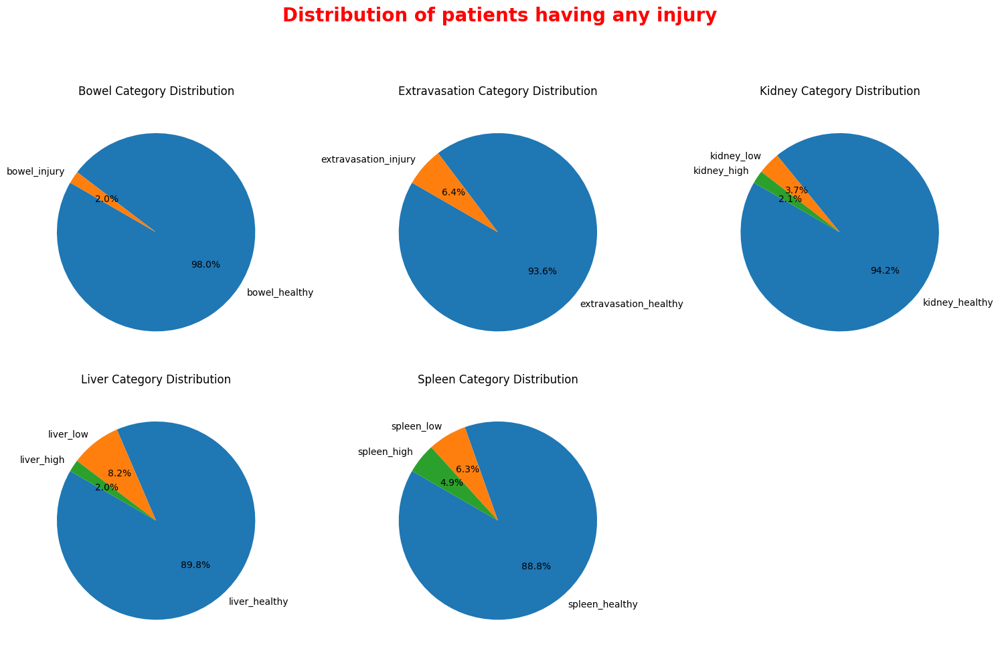

In [65]:
import matplotlib.pyplot as plt

# Create a mapping to convert numerical values back to text labels
label_mapping = {
    'bowel': {0: 'bowel_injury', 1: 'bowel_healthy'},
    'extravasation': {0: 'extravasation_injury', 1: 'extravasation_healthy'},
    'kidney': {-1: 'kidney_low', 0: 'kidney_high', 1: 'kidney_healthy'},
    'liver': {-1: 'liver_low', 0: 'liver_high', 1: 'liver_healthy'},
    'spleen': {-1: 'spleen_low', 0: 'spleen_high', 1: 'spleen_healthy'}
}

# Plot pie charts for each organ category using Seaborn styling
plt.figure(figsize=(15, 10))
# Add an overall title for the subplots
plt.suptitle('Distribution of patients having any injury',fontsize=20,color='red', fontweight='bold')

for i, organ in enumerate(label_mapping.keys()):
    # Convert numerical values back to text labels
    organ_counts = train_df[organ].replace(label_mapping[organ]).value_counts(normalize=True) * 100
    
    # Plot the pie chart
    plt.subplot(2, 3, i + 1)
    plt.pie(organ_counts, labels=organ_counts.index, autopct='%1.1f%%', startangle=150)
    plt.title(f"{organ.capitalize()} Category Distribution")
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.tight_layout(rect=[0, 0, 1, 0.92]) 
plt.show()



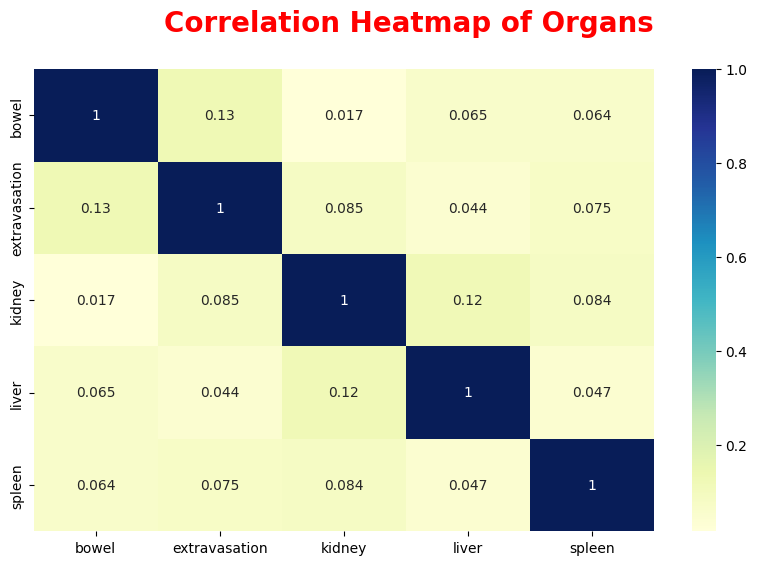

In [66]:
fea=fea=[col for col in train_df.columns if col not in ['patient_id', 'any_injury']]
x=train_df[fea].corr(method='pearson')
plt.figure(figsize=(10,6))
plt.suptitle('Correlation Heatmap of Organs',fontsize=20,color='red', fontweight='bold')
dataplot=sns.heatmap(x,cmap="YlGnBu",annot=True)
plt.show()

## 2. train_series_meta

In [3]:
train_series_meta = pd.read_csv('../Data/train_series_meta.csv')
train_series_meta.head()

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0
3,10007,47578,329.00,0
4,10026,29700,327.00,0


In [4]:
train_series_meta.shape

(4711, 4)

In [10]:
series=train_series_meta['series_id'].tolist()


In [13]:
if 397 in series:
    print("yes")

yes


In [5]:
train_series_meta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4711 entries, 0 to 4710
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   patient_id        4711 non-null   int64  
 1   series_id         4711 non-null   int64  
 2   aortic_hu         4711 non-null   float64
 3   incomplete_organ  4711 non-null   int64  
dtypes: float64(1), int64(3)
memory usage: 147.3 KB


In [6]:
train_series_meta.nunique()

patient_id          3147
series_id           4711
aortic_hu            717
incomplete_organ       2
dtype: int64

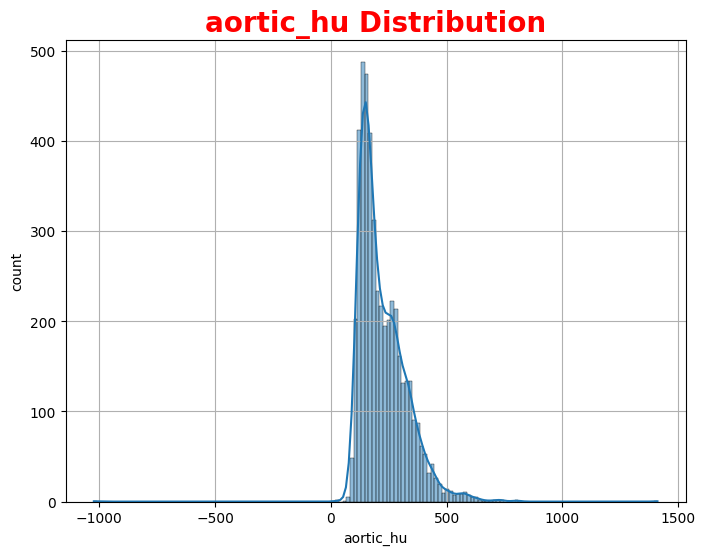

In [73]:
"""
In CT scans, "aortic Hounsfield units (HU)" measure the density of tissues within the aorta, the body's main artery. 
These units help identify conditions like artery blockages or calcifications.

The aorta is the largest artery in the human body, originating from the left ventricle of the heart and extending down through the chest and abdomen. 
It distributes oxygen-rich blood to the rest of the body. 
In CT scans, the aorta is often examined for abnormalities such as aneurysms, dissections, or atherosclerosis.

"""
plt.figure(figsize=(8, 6))
sns.histplot(train_series_meta['aortic_hu'], kde=True)
plt.title('aortic_hu Distribution',fontsize=20,color='red', fontweight='bold')
plt.xlabel('aortic_hu')
plt.ylabel('count')
plt.grid(True)
plt.show()

In [ ]:
train_series_meta[train_series_meta['aortic_hu']<0]

,patient_id,series_id,aortic_hu,incomplete_organ
1742,31284,58351,-1024.0,1


In [ ]:
train_series_meta[train_series_meta['aortic_hu']==0]

,patient_id,series_id,aortic_hu,incomplete_organ


In [ ]:
train_series_meta[train_series_meta['aortic_hu']>800]

,patient_id,series_id,aortic_hu,incomplete_organ
31,10275,37142,1411.0,0
2740,43774,64536,811.0,0


In [ ]:
train_series_meta['aortic_hu'].describe()

count    4711.000000
mean      223.622373
std       103.767762
min     -1024.000000
25%       147.000000
50%       194.000000
75%       280.000000
max      1411.000000
Name: aortic_hu, dtype: float64

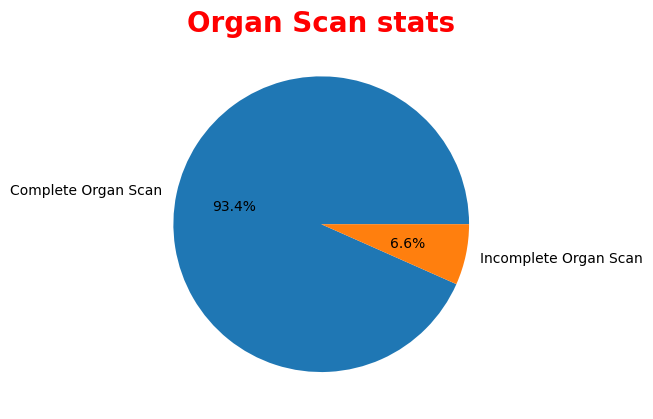

In [74]:
plt.pie(train_series_meta['incomplete_organ'].value_counts(), labels=['Complete Organ Scan','Incomplete Organ Scan'], autopct='%1.1f%%')
plt.title('Organ Scan stats',fontsize=20,color='red', fontweight='bold')
plt.show()
#For the most of the cases scans include complete organs.

## train_dicom_tags.parquet

In [2]:
import pandas as pd

In [3]:
train_dicom_tags = pd.read_parquet('../Data/train_dicom_tags.parquet')
train_dicom_tags.head()

,BitsAllocated,BitsStored,Columns,ContentDate,ContentTime,FrameOfReferenceUID,HighBit,ImageOrientationPatient,ImagePositionPatient,InstanceNumber,...,WindowCenter,WindowWidth,FileMetaInformationVersion,ImplementationClassUID,ImplementationVersionName,MediaStorageSOPClassUID,MediaStorageSOPInstanceUID,TransferSyntaxUID,path,RescaleType
0,16,16,512,20230722,003306.881589,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1459.20]",532,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.532,1.2.840.10008.1.2.5,train_images/49954/41479/532.dcm,nan
1,16,16,512,20230722,003303.279137,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1474.40]",513,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.513,1.2.840.10008.1.2.5,train_images/49954/41479/513.dcm,nan
2,16,16,512,20230722,003343.090736,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1310.40]",718,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.718,1.2.840.10008.1.2.5,train_images/49954/41479/718.dcm,nan
3,16,16,512,20230722,003252.960345,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1520.00]",456,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.456,1.2.840.10008.1.2.5,train_images/49954/41479/456.dcm,nan
4,16,16,512,20230722,003155.059398,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1756.00]",161,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.161,1.2.840.10008.1.2.5,train_images/49954/41479/161.dcm,nan


In [12]:
filtered_df = train_dicom_tags[train_dicom_tags['PatientID'] == '1049']

In [13]:
filtered_df

,BitsAllocated,BitsStored,Columns,ContentDate,ContentTime,FrameOfReferenceUID,HighBit,ImageOrientationPatient,ImagePositionPatient,InstanceNumber,...,WindowCenter,WindowWidth,FileMetaInformationVersion,ImplementationClassUID,ImplementationVersionName,MediaStorageSOPClassUID,MediaStorageSOPInstanceUID,TransferSyntaxUID,path,RescaleType
1048524,16,16,512,20230722,003141.280079,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1484.4]",513,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.513,1.2.840.10008.1.2.5,train_images/33648/29865/513.dcm,nan
1048525,16,16,512,20230722,003008.888671,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1870.8]",30,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.30,1.2.840.10008.1.2.5,train_images/33648/29865/30.dcm,nan
1048526,16,16,512,20230722,003130.047031,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1530.0]",456,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.456,1.2.840.10008.1.2.5,train_images/33648/29865/456.dcm,nan
1048527,16,16,512,20230722,003033.881734,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1766.0]",161,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.161,1.2.840.10008.1.2.5,train_images/33648/29865/161.dcm,nan
1048528,16,16,512,20230722,003104.067482,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1638.0]",321,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.321,1.2.840.10008.1.2.5,train_images/33648/29865/321.dcm,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1049279,16,16,512,20230722,002935.387988,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1884.0]",226,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.226,1.2.840.10008.1.2.5,train_images/33648/23313/226.dcm,nan
1049280,16,16,512,20230722,002939.628214,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1867.2]",247,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.247,1.2.840.10008.1.2.5,train_images/33648/23313/247.dcm,nan
1049281,16,16,512,20230722,002954.868756,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1805.6]",324,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.324,1.2.840.10008.1.2.5,train_images/33648/23313/324.dcm,nan
1049282,16,16,512,20230722,002924.518656,1.2.826.0.1.3680043.8.498.36746917192249441104...,15,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-95.39223, -158.8687, 1931.2]",167,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.33648.1.167,1.2.840.10008.1.2.5,train_images/33648/23313/167.dcm,nan


In [ ]:
train_dicom_tags['path'] = train_dicom_tags['path'].str.replace('.dcm', '.jpeg')

In [ ]:
train_dicom_tags['path'] = '../Data/' + train_dicom_tags['path']

In [ ]:
train_dicom_tags.shape

(1500653, 35)

### In total we have 1500653 images.

In [ ]:
print("Number of rows: ", train_dicom_tags.shape[0])
print("Number of images: ", train_dicom_tags['path'].nunique())

Number of rows:  1500653
Number of images:  1500653


In [4]:
train_dicom_tags.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500653 entries, 0 to 1500652
Data columns (total 35 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   BitsAllocated               1500653 non-null  int64  
 1   BitsStored                  1500653 non-null  int64  
 2   Columns                     1500653 non-null  int64  
 3   ContentDate                 1500653 non-null  object 
 4   ContentTime                 1500653 non-null  object 
 5   FrameOfReferenceUID         1500653 non-null  object 
 6   HighBit                     1500653 non-null  int64  
 7   ImageOrientationPatient     1500653 non-null  object 
 8   ImagePositionPatient        1500653 non-null  object 
 9   InstanceNumber              1500653 non-null  int64  
 10  KVP                         1500653 non-null  float64
 11  PatientID                   1500653 non-null  object 
 12  PatientPosition             1500653 non-null  object 
 1

In [7]:
train_dicom_tags.head(1)

,BitsAllocated,BitsStored,Columns,ContentDate,ContentTime,FrameOfReferenceUID,HighBit,ImageOrientationPatient,ImagePositionPatient,InstanceNumber,...,WindowCenter,WindowWidth,FileMetaInformationVersion,ImplementationClassUID,ImplementationVersionName,MediaStorageSOPClassUID,MediaStorageSOPInstanceUID,TransferSyntaxUID,path,RescaleType
0,16,16,512,20230722,003306.881589,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1459.20]",532,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.532,1.2.840.10008.1.2.5,train_images/49954/41479/532.dcm,nan


In [8]:
import pandas as pd

# Load Parquet file into DataFrame
train_dicom_tags = pd.read_parquet('../Data/train_dicom_tags.parquet')

# Convert DataFrame to CSV
csv_filename = '../Data/train_dicom_tags.csv'
train_dicom_tags.to_csv(csv_filename, index=False)

print(f"DataFrame successfully converted and saved to: {csv_filename}")


DataFrame successfully converted and saved to: ../Data/train_dicom_tags.csv


In [ ]:
train_dicom_tags.nunique()

BitsAllocated                       1
BitsStored                          3
Columns                           135
ContentDate                         2
ContentTime                   1499130
FrameOfReferenceUID              3147
HighBit                             3
ImageOrientationPatient           172
ImagePositionPatient          1418128
InstanceNumber                   1971
KVP                                10
PatientID                        3147
PatientPosition                     2
PhotometricInterpretation           1
PixelRepresentation                 2
PixelSpacing                      804
RescaleIntercept                    4
RescaleSlope                        1
Rows                                6
SOPInstanceUID                1208829
SamplesPerPixel                     1
SeriesInstanceUID                4711
SeriesNumber                      134
SliceThickness                     18
StudyInstanceUID                 3147
WindowCenter                        1
WindowWidth 

In [ ]:
# List to store indices of rows with missing image files
missing_paths_indices = []

# Iterate over the DataFrame and check if each path exists
for index, row in train_dicom_tags.iterrows():
    if not os.path.exists(row['path']):
        missing_paths_indices.append(index)

In [ ]:
np.round(len(missing_paths_indices)/ len (train_dicom_tags)*100,1)

67.5

In [ ]:
# Create a new DataFrame excluding the rows with missing paths
updated_train_dicom_tags = train_dicom_tags.drop(index=missing_paths_indices)

# Reset the index of the cleaned DataFrame
updated_train_dicom_tags.reset_index(drop=True, inplace=True)

# Save the cleaned DataFrame to a new file (optional)
updated_train_dicom_tags.to_parquet('../Data/updated_train_dicom_tags.parquet')

# Display the cleaned DataFrame
print(updated_train_dicom_tags.head())

   BitsAllocated  BitsStored  Columns ContentDate    ContentTime  \
0             16          16      512    20230722  003252.960345   
1             16          16      512    20230722  003155.059398   
2             16          16      512    20230722  003358.562591   
3             16          16      512    20230722  003226.785417   
4             16          16      512    20230722  003203.598203   

                                 FrameOfReferenceUID  HighBit  \
0  1.2.826.0.1.3680043.8.498.28466454913303094199...       15   
1  1.2.826.0.1.3680043.8.498.28466454913303094199...       15   
2  1.2.826.0.1.3680043.8.498.28466454913303094199...       15   
3  1.2.826.0.1.3680043.8.498.28466454913303094199...       15   
4  1.2.826.0.1.3680043.8.498.28466454913303094199...       15   

                             ImageOrientationPatient  \
0  [1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...   
1  [1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...   
2  [1.00000, 0.00000, 0.00000, 0

In [ ]:
len(updated_train_dicom_tags)

487197

In [17]:
updated_train_dicom_tags = pd.read_parquet('../Data/updated_train_dicom_tags.parquet')
# Select the directory of a specific image
file_path = updated_train_dicom_tags['path'].iloc[101]
dir_name = os.path.dirname(file_path)

# Retrieve all JPEG image paths from the directory
image_paths = [os.path.join(dir_name, fname) for fname in os.listdir(dir_name) if fname.endswith('.jpeg')]

# Sort image paths to maintain order
image_paths.sort()

# Load each image and store in a list
images = [mpimg.imread(img_path) for img_path in image_paths]

# Create a figure and axes
fig, ax = plt.subplots()

# Display the first image
img_display = ax.imshow(images[0])
ax.axis('off')  # Remove axis labels

def update(frame):
    img_display.set_array(images[frame])
    return img_display,

# Create the animation
ani = FuncAnimation(fig, update, frames=len(images), interval=500, blit=True)

# Save the animation as a GIF
gif_path = os.path.join('../Outputs/EDA', 'train_images.gif')
ani.save(gif_path, writer=PillowWriter(fps=2))  # Adjust FPS as needed

# Display the saved GIF path
print(f"GIF saved to {gif_path}")


def start_animation(b):
    ani.event_source.start()

def pause_animation(b):
    ani.event_source.stop()

# display(widgets.HBox([start_button, pause_button]))
plt.close()  # Prevents duplicate figure display

# Display the animation in the notebook
HTML(ani.to_jshtml())

GIF saved to ../Outputs/EDA\train_images.gif


Animation size has reached 21098846 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Image saved to ../Outputs/EDA/segmentation_slices.jpeg


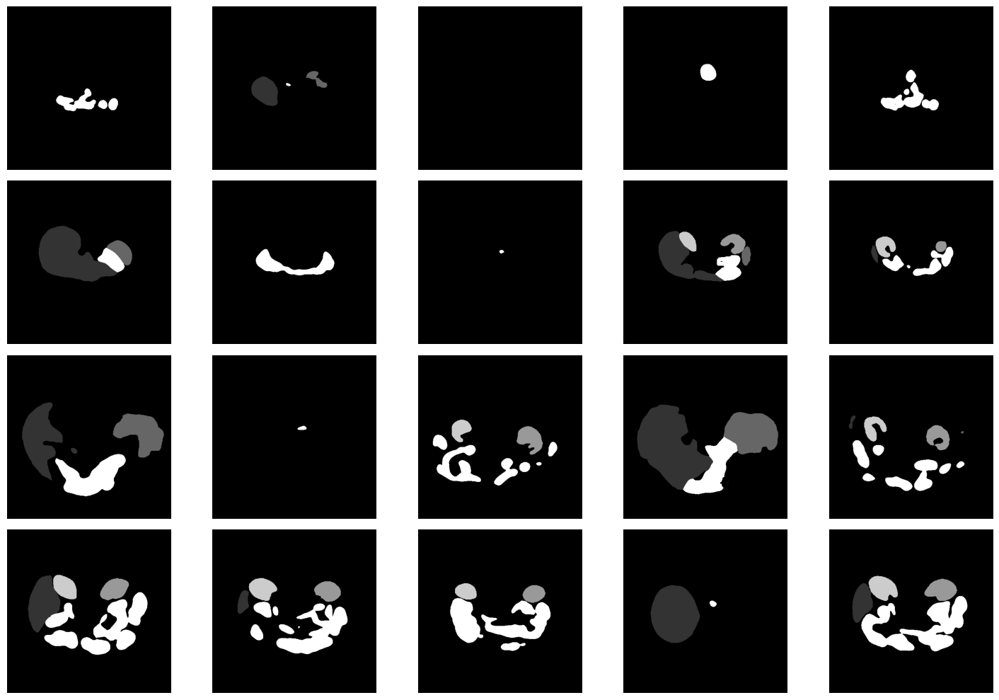

In [12]:
# Function to load NIfTI image
def load_nifti_image(file_path):
    img = sitk.ReadImage(file_path)
    data = sitk.GetArrayFromImage(img)
    return data

# Directory containing NIfTI segmentation files
segmentation_dir = '../Data/segmentations/'

# Retrieve all NIfTI file paths from the directory
segmentation_files = [os.path.join(segmentation_dir, fname) for fname in os.listdir(segmentation_dir) if fname.endswith('.nii')]

# Load each NIfTI image and store slices in a list (for demonstration, let's consider random slices of the first few images)
num_images_to_display = 4  # Number of images to consider
num_slices_per_image = 5  # Number of slices per image to display
slices = []

for seg_file in segmentation_files[:num_images_to_display]:
    seg = load_nifti_image(seg_file)
    # print(f"Loaded {seg.shape} from {seg_file}")  # Debug print
    total_slices = seg.shape[0]
    random_slices = random.sample(range(total_slices), min(total_slices, num_slices_per_image))
    for i in random_slices:
        slices.append(seg[i, :, :])

# Plot the slices in a grid
num_rows = num_images_to_display
num_cols = num_slices_per_image

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

for i in range(num_rows):
    for j in range(num_cols):
        index = i * num_slices_per_image + j
        if index < len(slices):
            axes[i, j].imshow(slices[index], cmap='gray')
            axes[i, j].axis('off')  # Remove axis labels

plt.tight_layout()

# Save the plot to a file
output_image_path = '../Outputs/EDA/segmentation_slices.jpeg'
plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0.1)
print(f"Image saved to {output_image_path}")

plt.show()


Loaded (483, 512, 512) from ../Data/segmentations/10000.nii
Loaded (250, 512, 512) from ../Data/segmentations/10109.nii
Loaded (828, 512, 512) from ../Data/segmentations/10180.nii
Image saved to ../Outputs/EDA/segmentation_slices_1.png


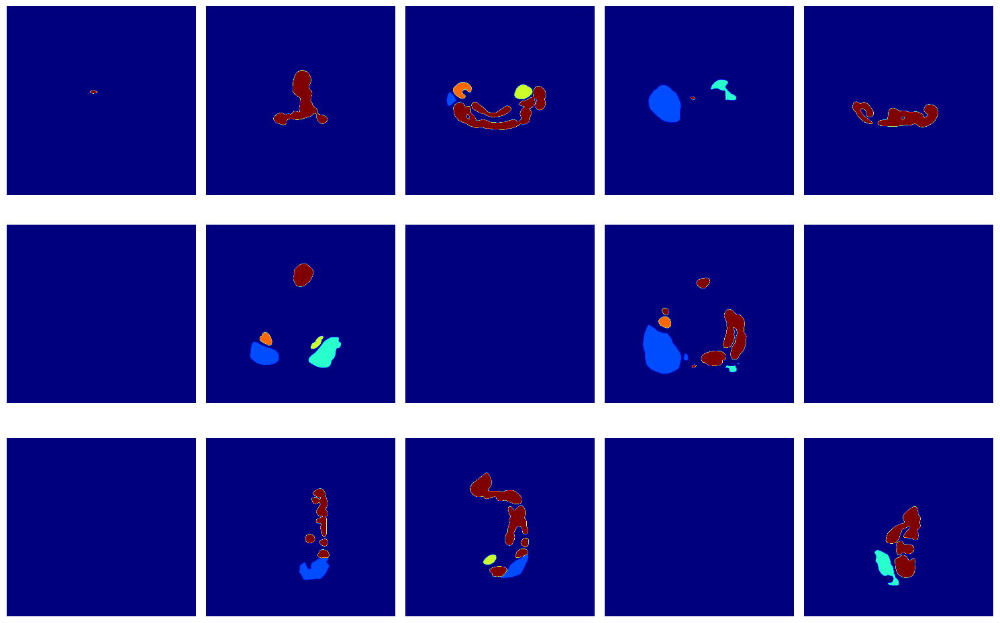

In [77]:
import os
import random
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt

# Function to load NIfTI image
def load_nifti_image(file_path):
    img = sitk.ReadImage(file_path)
    data = sitk.GetArrayFromImage(img)
    return data

# Directory containing NIfTI segmentation files
segmentation_dir = '../Data/segmentations/'

# Retrieve all NIfTI file paths from the directory
segmentation_files = [os.path.join(segmentation_dir, fname) for fname in os.listdir(segmentation_dir) if fname.endswith('.nii')]

# Function to get random slices from a given orientation
def get_random_slices(image, orientation, num_slices):
    if orientation == 'Axial':
        total_slices = image.shape[0]
        random_indices = random.sample(range(total_slices), min(total_slices, num_slices))
        slices = [image[i, :, :] for i in random_indices]
    elif orientation == 'Coronal':
        total_slices = image.shape[1]
        random_indices = random.sample(range(total_slices), min(total_slices, num_slices))
        slices = [image[:, i, :] for i in random_indices]
    elif orientation == 'Sagittal':
        total_slices = image.shape[2]
        random_indices = random.sample(range(total_slices), min(total_slices, num_slices))
        slices = [image[:, :, i] for i in random_indices]
    return slices

# Load and store random slices for each orientation
num_images_to_display = 3  # Number of images to consider
num_slices_per_image = 5  # Number of slices per image to display

all_slices = {'Axial': [], 'Coronal': [], 'Sagittal': []}
orientations = ['Axial', 'Coronal', 'Sagittal']

for seg_file in segmentation_files[:num_images_to_display]:
    seg = load_nifti_image(seg_file)
    print(f"Loaded {seg.shape} from {seg_file}")  # Debug print
    for orientation in orientations:
        slices = get_random_slices(seg, orientation, num_slices_per_image)
        all_slices[orientation].extend(slices)

# Plot the slices in a grid
num_rows = len(orientations)
num_cols = num_slices_per_image

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

for i, orientation in enumerate(orientations):
    for j in range(num_cols):
        index = j
        if index < len(all_slices[orientation]):
            axes[i, j].imshow(all_slices[orientation][index], cmap='jet')  # Apply color map for segmentation
            axes[i, j].axis('off')  # Remove axis labels
        if j == 0:
            axes[i, j].set_ylabel(orientation, fontsize=12, rotation=0, labelpad=60)  # Label the rows

plt.tight_layout()

# Save the plot to a file
output_image_path = '../Outputs/EDA/segmentation_slices_1.png'
plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0.1)
print(f"Image saved to {output_image_path}")

plt.show()


## image_level_labels.csv

In [ ]:
image_level_labels = pd.read_csv('../Data/image_level_labels.csv')
image_level_labels.head()

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation
2,10004,21057,364,Active_Extravasation
3,10004,21057,365,Active_Extravasation
4,10004,21057,366,Active_Extravasation


In [33]:
image_level_labels.shape

(12029, 4)

In [34]:
print(f"Injury Type: {image_level_labels['injury_name'].unique()} \
      \nNumber of patients: {image_level_labels['patient_id'].nunique()} \
      \nNumber of series_id: {image_level_labels['series_id'].nunique()}")


Injury Type: ['Active_Extravasation' 'Bowel']       
Number of patients: 246       
Number of series_id: 330


11536


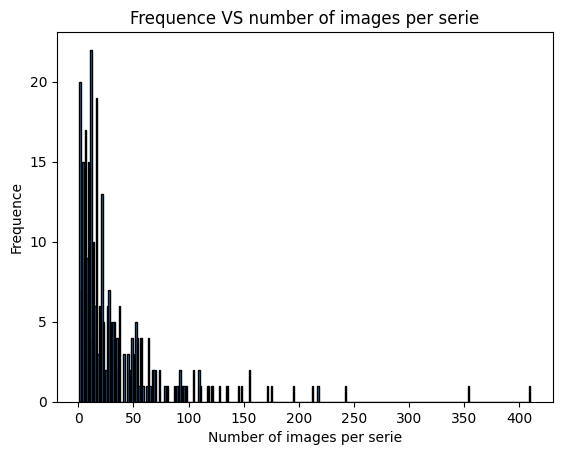

In [35]:
data = image_level_labels.groupby('series_id')['instance_number'].nunique()
print(sum(data))
plt.hist(data, bins=len(data), edgecolor='black')  
plt.xlabel('Number of images per serie')
plt.ylabel('Frequence')
plt.title('Frequence VS number of images per serie')
plt.show()

## segmentations

In [39]:
files = glob('../Data/segmentations/' + '*')
len(files)

206

#### So out of the 3147 patients we have been provided with the segmentations of the 206 patients only. But can we extract the segmentations for the remaining images by using the segmentor model by using which the provided segmentations has been extracted.

In [70]:
updated_train_dicom_tags = pd.read_parquet('../Data/updated_train_dicom_tags.parquet')

In [116]:
train_df = pd.read_csv("../Data/updated_train.csv")
train_series_meta = pd.read_csv('../Data/train_series_meta.csv')

In [117]:
# Assuming you have your dataframes already loaded as train_series_meta_df and updated_train_df
# Merge the dataframes on 'patient_id'
merged_df = pd.merge(train_series_meta, train_df, on='patient_id')

# Display the merged dataframe
merged_df.head()


,patient_id,series_id,aortic_hu,incomplete_organ,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,21057,146.00,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10004,51033,454.75,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
2,10005,18667,187.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10007,47578,329.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10026,29700,327.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [3]:
merged_df = pd.read_csv('../Data/merged_dataframe.csv')
merged_df.head()

,patient_id,series_id,aortic_hu,incomplete_organ,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,21057,146.00,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10004,51033,454.75,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
2,10005,18667,187.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10007,47578,329.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10026,29700,327.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [4]:
# Combine 'patient_id' and 'series_id' columns with an underscore
merged_df['combined_id'] = merged_df['patient_id'].astype(str) + '_' + merged_df['series_id'].astype(str)
merged_df.head()

,patient_id,series_id,aortic_hu,incomplete_organ,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury,combined_id
0,10004,21057,146.00,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1,10004_21057
1,10004,51033,454.75,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1,10004_51033
2,10005,18667,187.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,10005_18667
3,10007,47578,329.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,10007_47578
4,10026,29700,327.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,10026_29700


In [5]:
output_csv_path = '../Data/merged_dataframe.csv'
merged_df.to_csv(output_csv_path, index=False)

In [119]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4711 entries, 0 to 4710
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   patient_id             4711 non-null   int64  
 1   series_id              4711 non-null   int64  
 2   aortic_hu              4711 non-null   float64
 3   incomplete_organ       4711 non-null   int64  
 4   bowel_healthy          4711 non-null   int64  
 5   bowel_injury           4711 non-null   int64  
 6   extravasation_healthy  4711 non-null   int64  
 7   extravasation_injury   4711 non-null   int64  
 8   kidney_healthy         4711 non-null   int64  
 9   kidney_low             4711 non-null   int64  
 10  kidney_high            4711 non-null   int64  
 11  liver_healthy          4711 non-null   int64  
 12  liver_low              4711 non-null   int64  
 13  liver_high             4711 non-null   int64  
 14  spleen_healthy         4711 non-null   int64  
 15  sple

In [75]:
files = glob('../Data/segmentations/' + '*')
def extract_number_from_filenames(filenames):
    numbers = []
    for filename in filenames:
        # Split the filename on the backslash to get the actual file name
        actual_filename = filename.split('\\')[-1]
        # Remove the '.nii' extension
        number_str = actual_filename.replace('.nii', '')
        numbers.append(number_str)
    return numbers

numbers = extract_number_from_filenames(files)


In [76]:
def check_all_numbers_in_series_id(numbers, merged_df):
    series_ids = set(merged_df['series_id'].astype(str))  # Ensure series_id is of string type
    missing_numbers = [num for num in numbers if num not in series_ids]
    return len(missing_numbers) == 0, missing_numbers

In [77]:
# Check if all numbers are in series_id
all_present, missing_values = check_all_numbers_in_series_id(numbers, merged_df)
print(all_present, missing_values)

True []


## correct 

Shape of NIfTI data: (512, 512, 245)


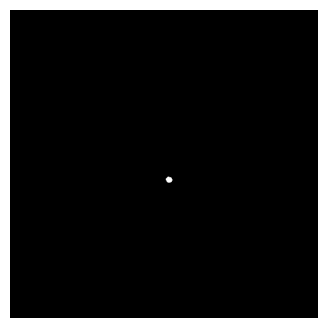

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0030.png


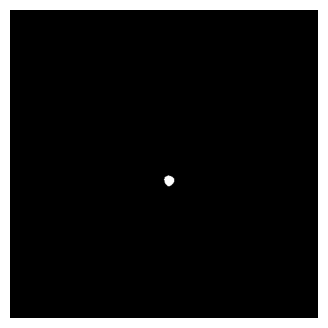

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0031.png


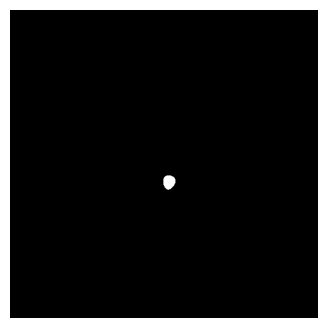

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0032.png


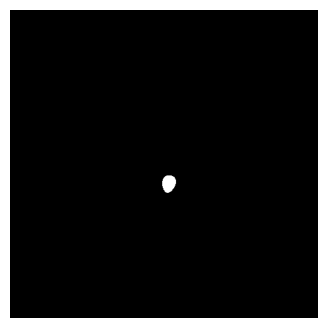

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0033.png


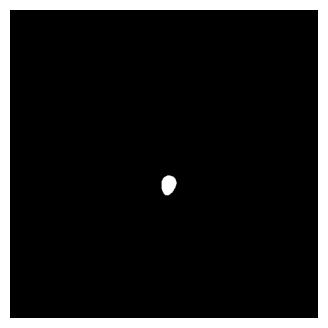

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0034.png


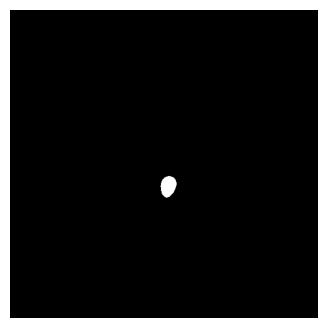

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0035.png


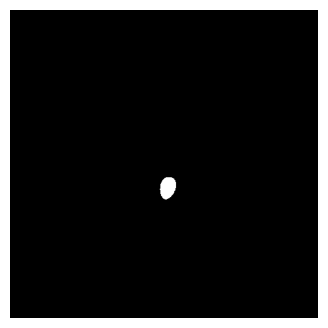

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0036.png


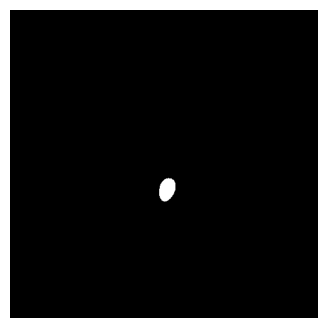

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0037.png


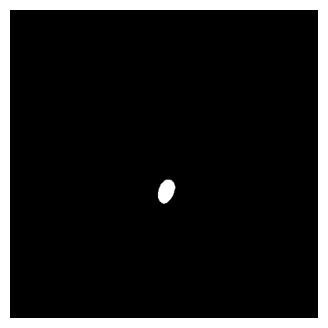

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0038.png


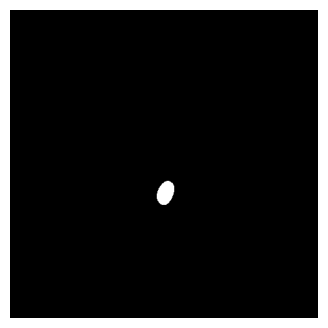

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0039.png


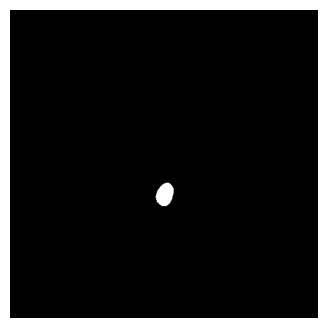

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0040.png


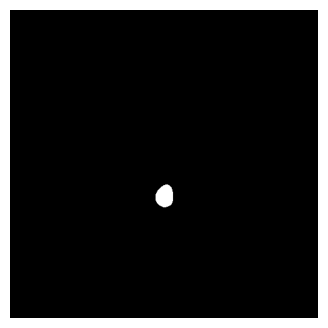

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0041.png


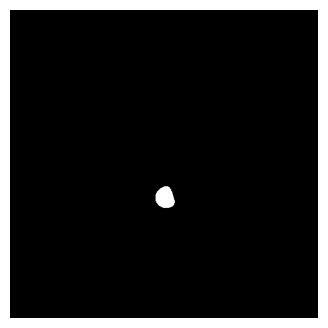

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0042.png


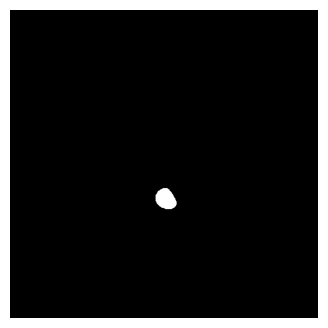

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0043.png


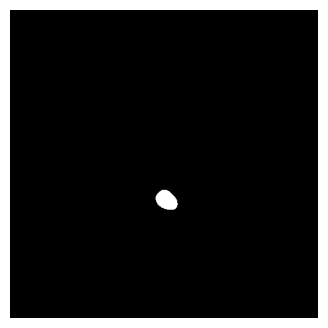

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0044.png


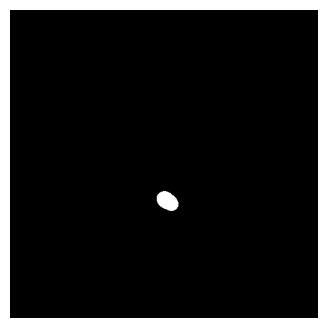

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0045.png


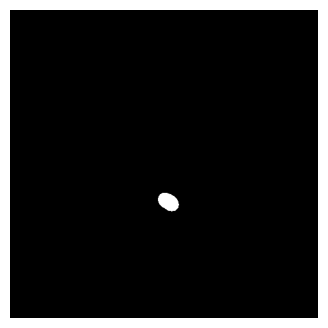

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0046.png


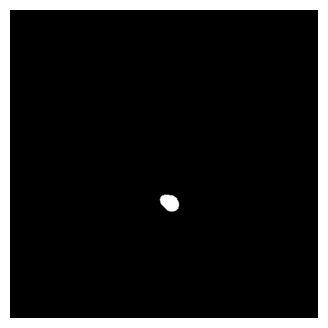

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0047.png


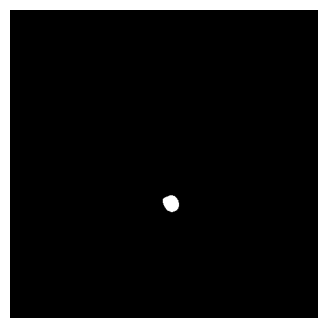

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0048.png


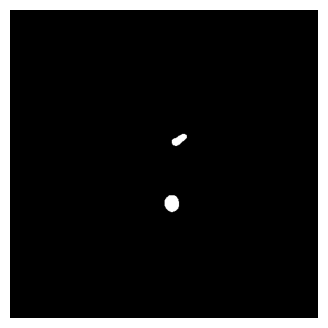

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0049.png


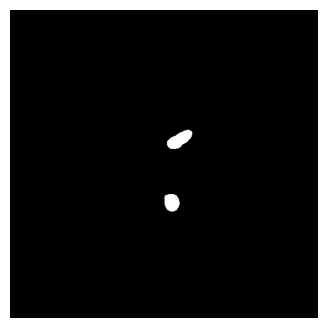

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0050.png


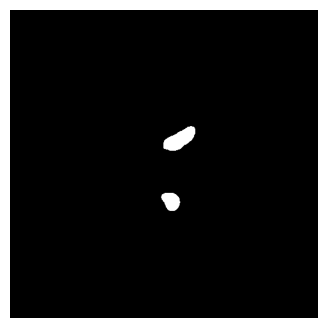

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0051.png


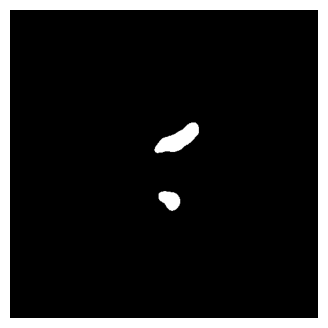

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0052.png


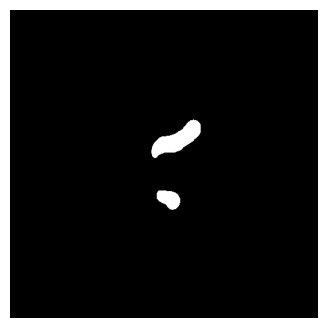

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0053.png


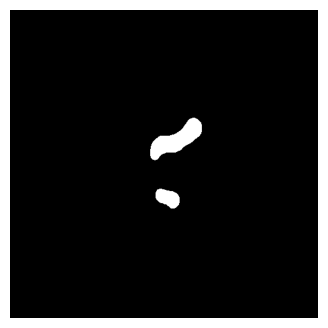

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0054.png


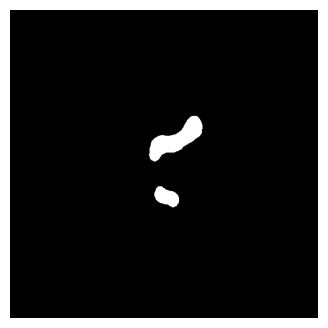

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0055.png


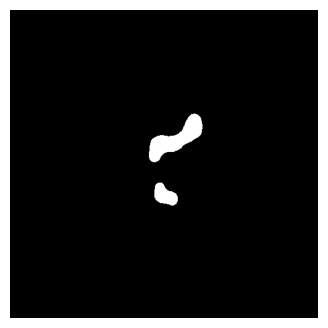

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0056.png


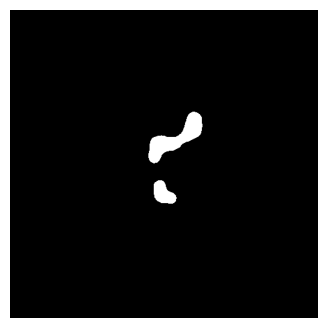

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0057.png


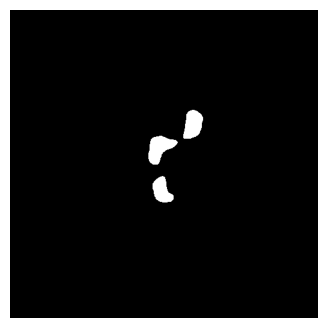

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0058.png


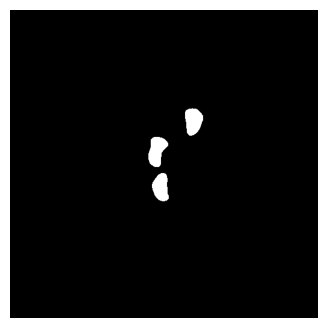

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0059.png


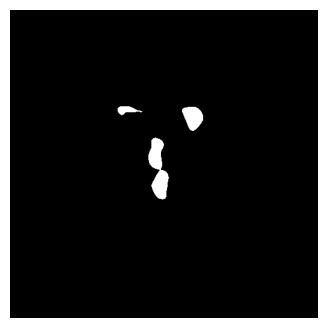

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0060.png


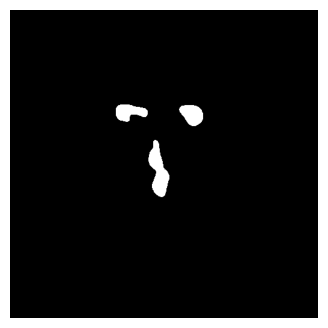

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0061.png


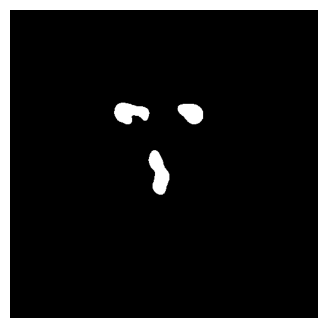

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0062.png


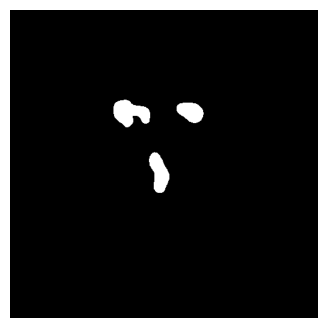

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0063.png


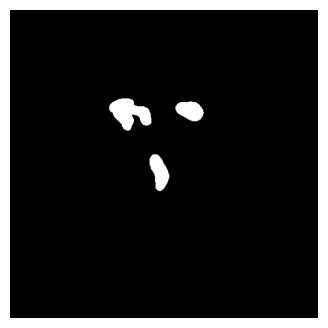

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0064.png


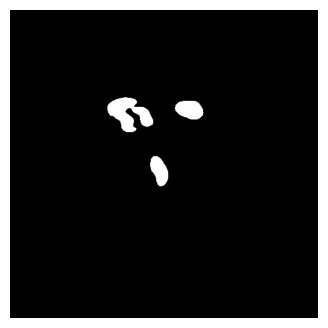

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0065.png


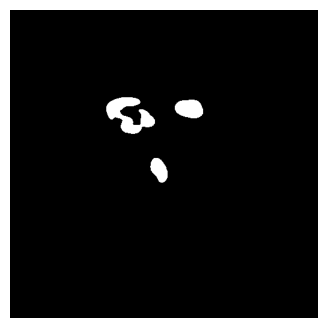

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0066.png


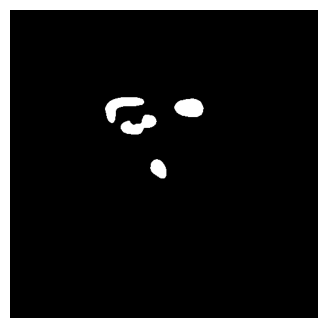

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0067.png


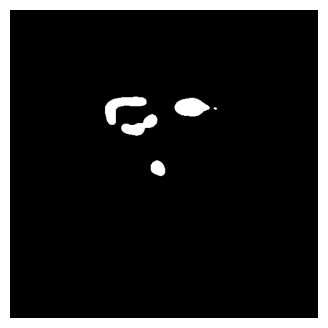

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0068.png


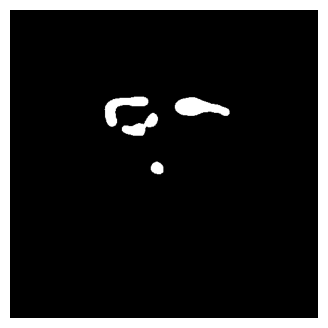

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0069.png


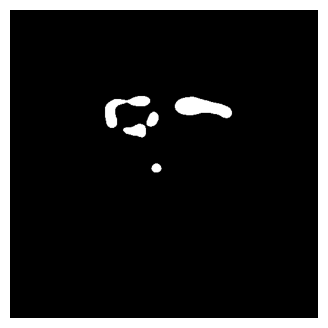

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0070.png


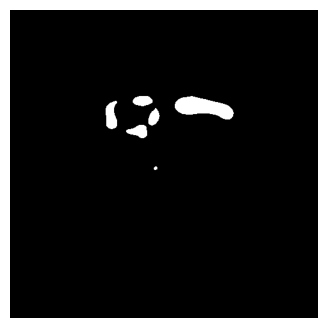

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0071.png


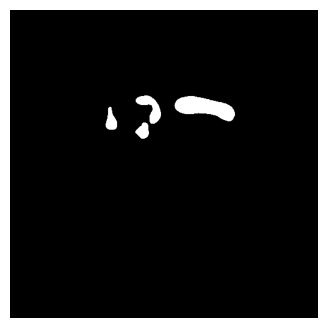

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0072.png


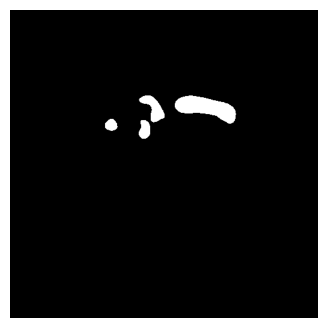

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0073.png


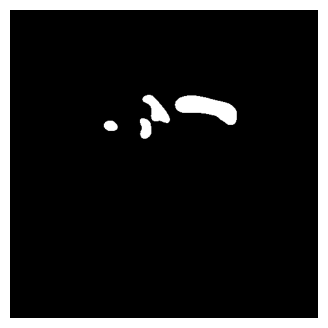

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0074.png


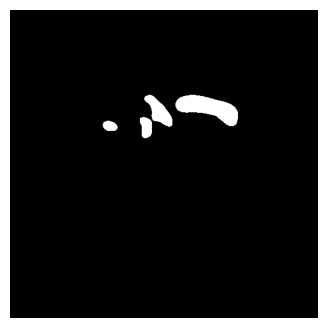

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0075.png


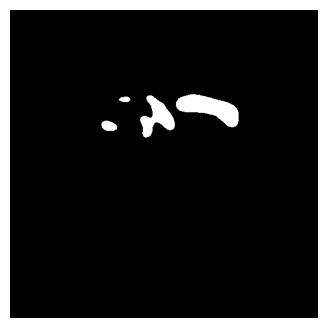

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0076.png


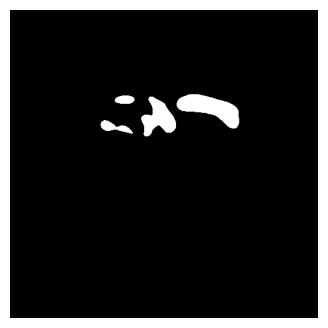

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0077.png


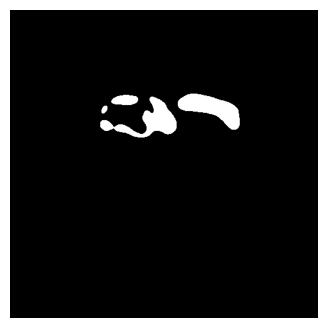

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0078.png


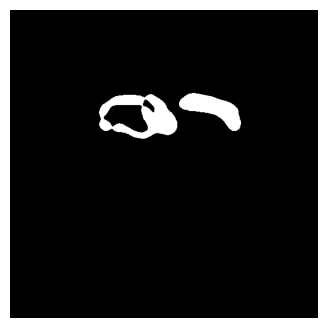

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0079.png


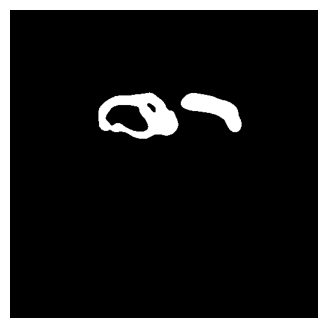

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0080.png


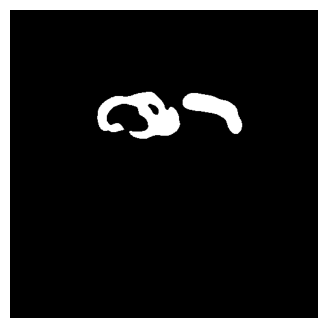

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0081.png


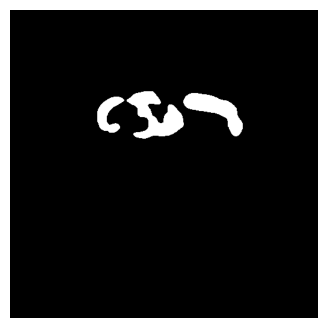

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0082.png


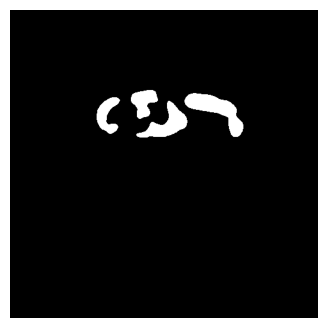

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0083.png


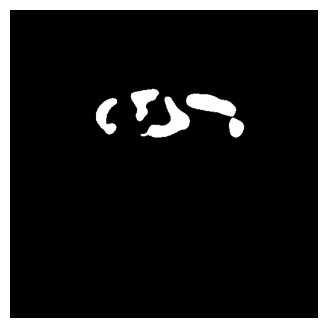

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0084.png


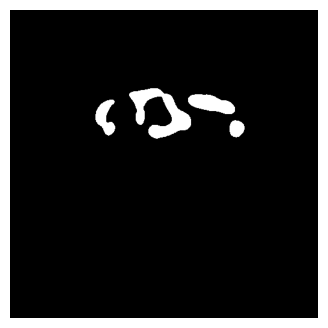

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0085.png


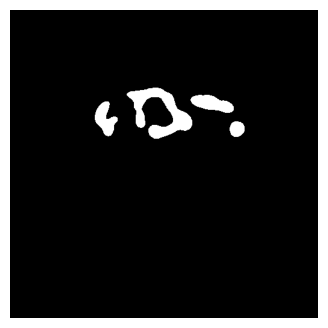

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0086.png


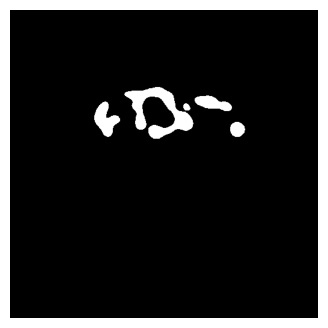

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0087.png


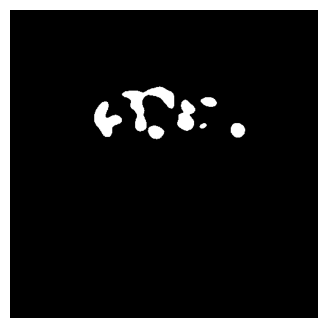

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0088.png


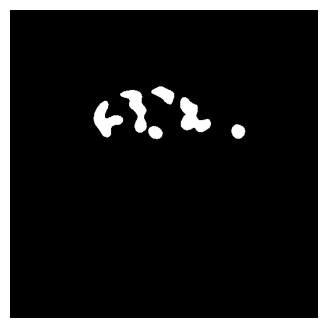

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0089.png


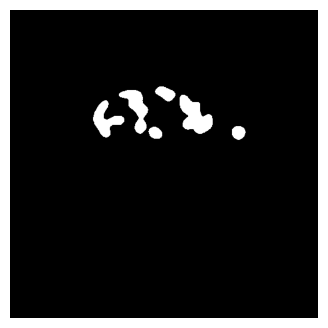

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0090.png


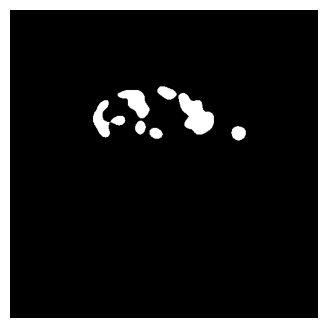

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0091.png


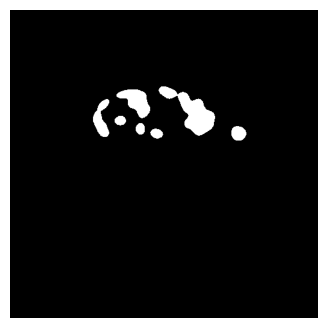

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0092.png


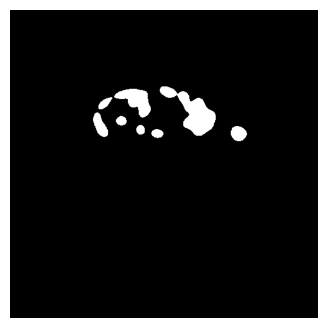

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0093.png


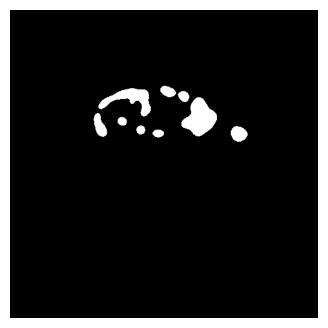

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0094.png


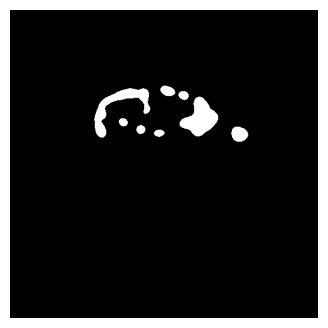

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0095.png


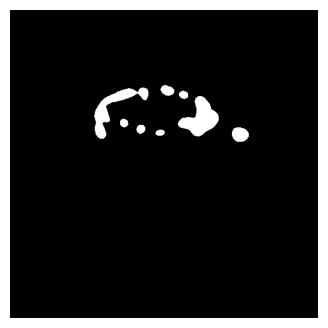

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0096.png


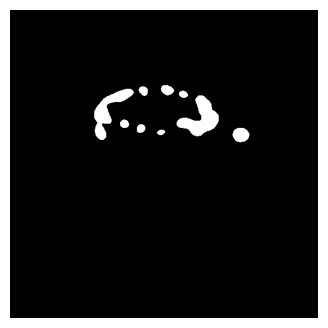

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0097.png


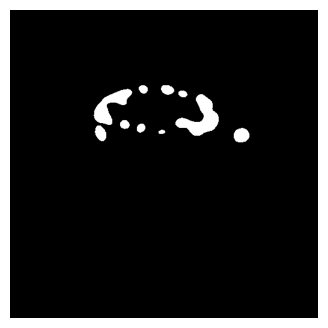

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0098.png


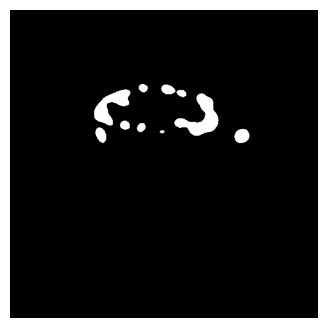

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0099.png


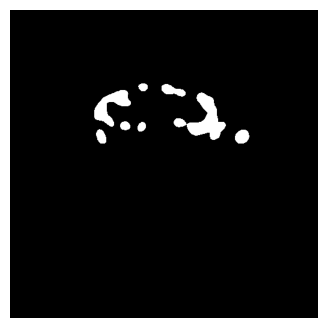

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0100.png


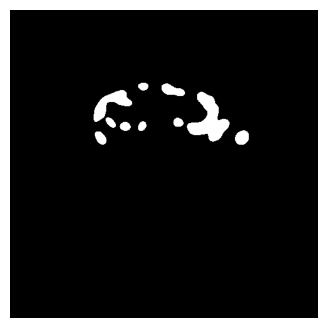

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0101.png


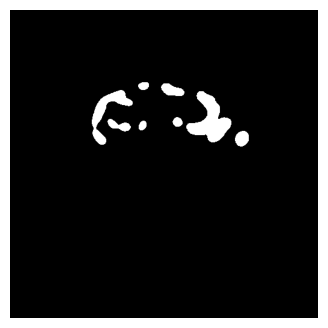

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0102.png


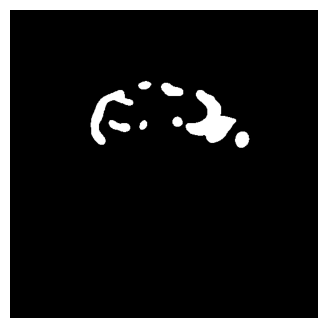

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0103.png


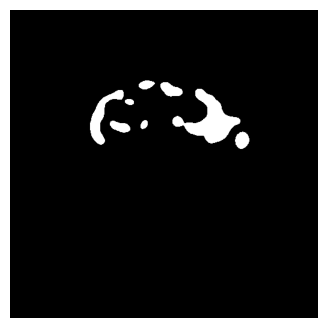

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0104.png


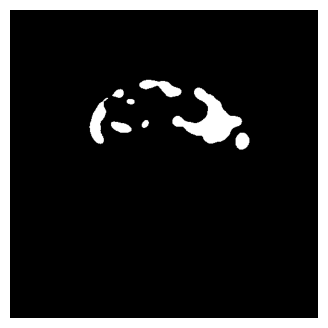

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0105.png


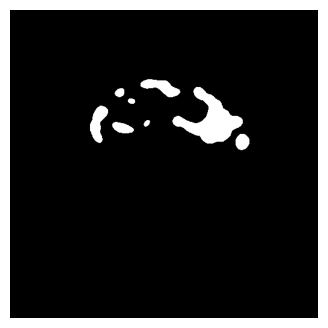

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0106.png


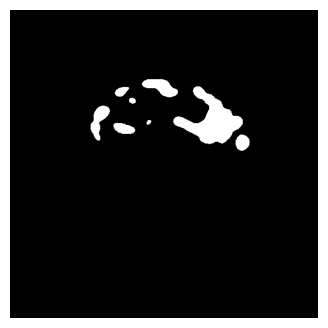

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0107.png


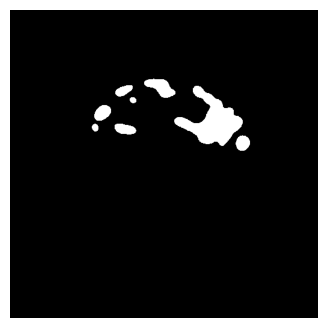

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0108.png


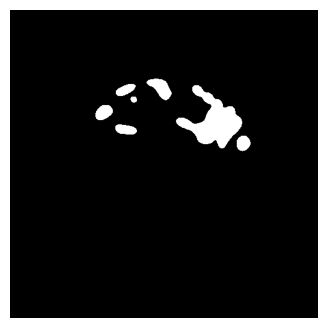

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0109.png


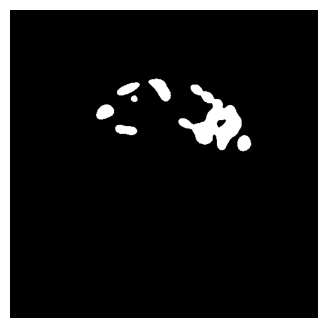

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0110.png


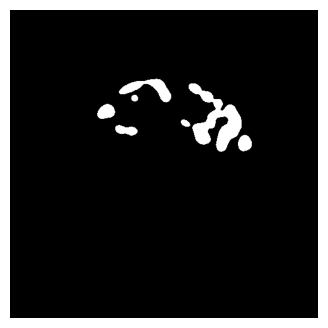

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0111.png


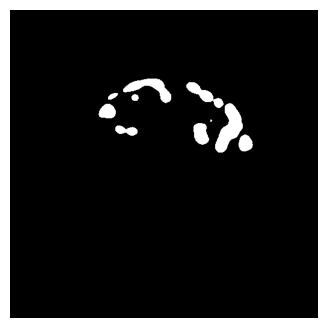

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0112.png


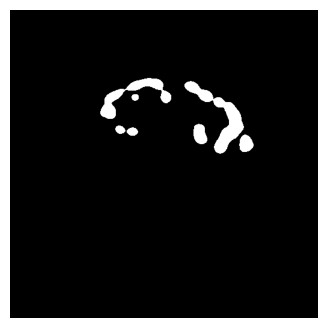

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0113.png


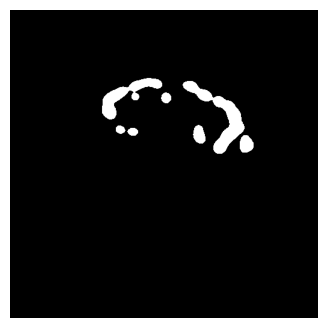

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0114.png


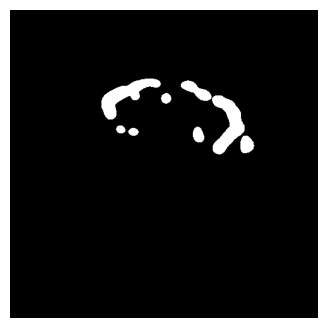

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0115.png


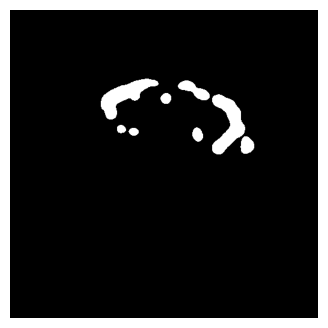

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0116.png


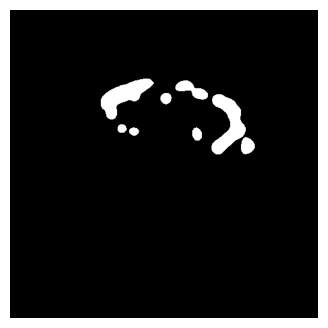

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0117.png


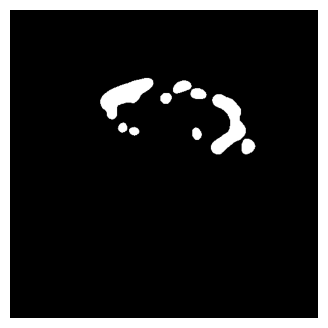

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0118.png


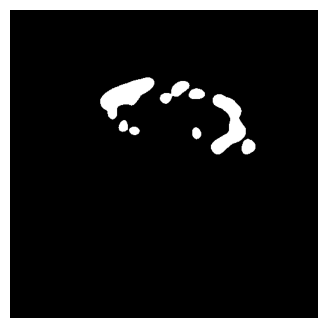

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0119.png


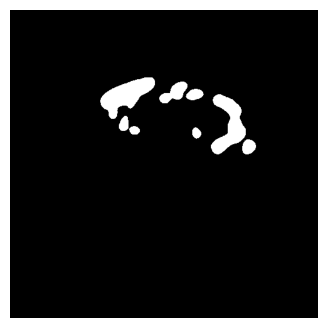

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0120.png


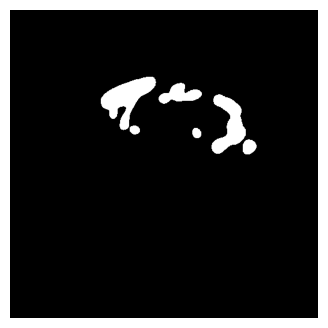

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0121.png


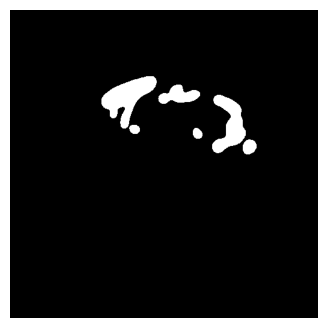

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0122.png


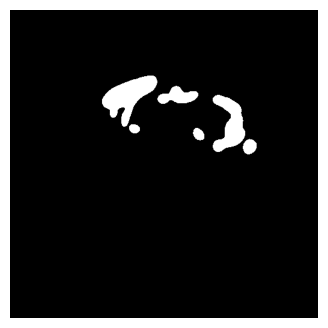

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0123.png


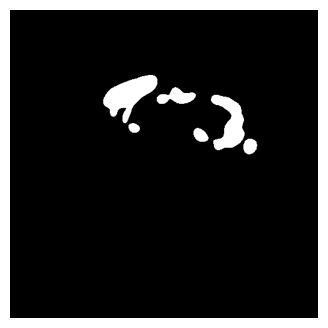

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0124.png


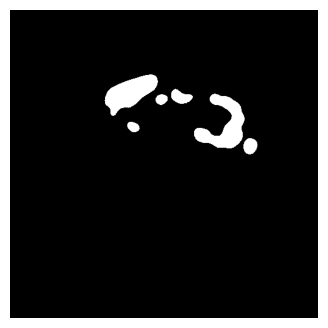

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0125.png


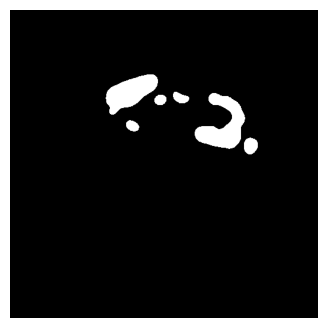

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0126.png


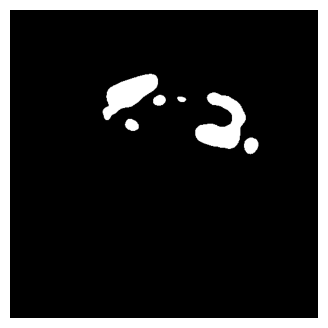

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0127.png


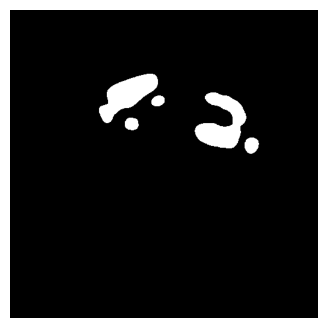

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0128.png


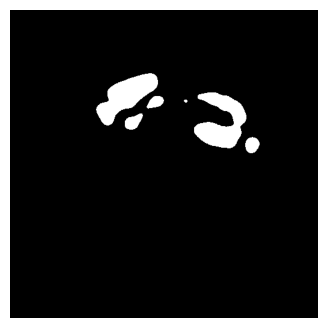

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0129.png


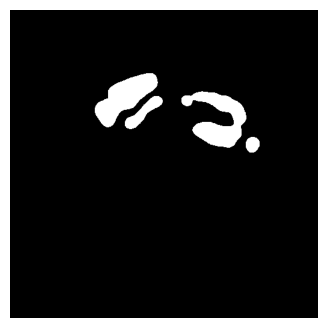

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0130.png


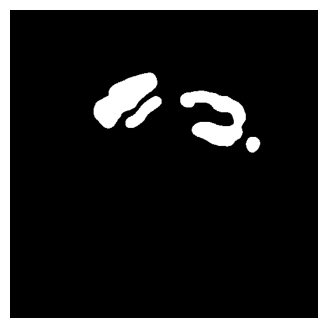

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0131.png


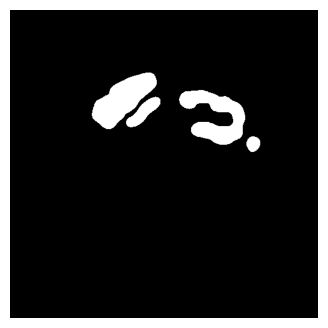

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0132.png


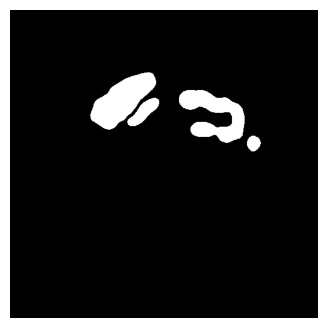

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0133.png


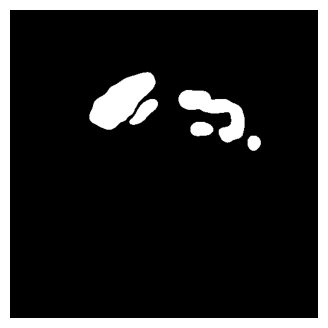

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0134.png


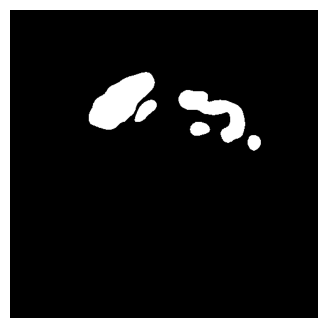

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0135.png


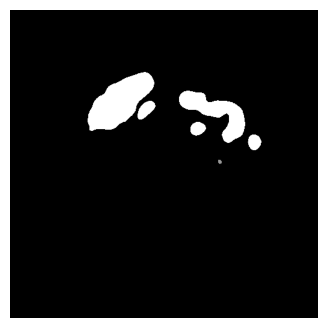

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0136.png


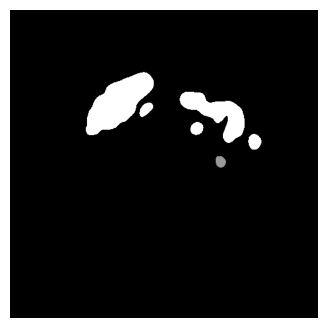

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0137.png


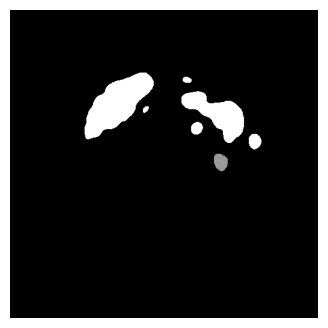

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0138.png


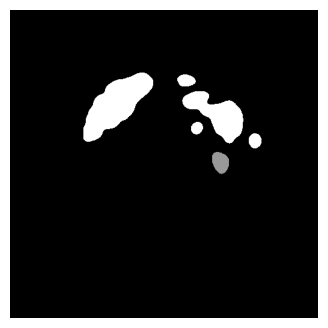

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0139.png


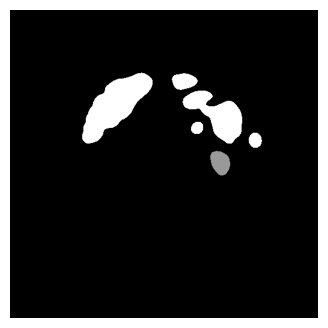

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0140.png


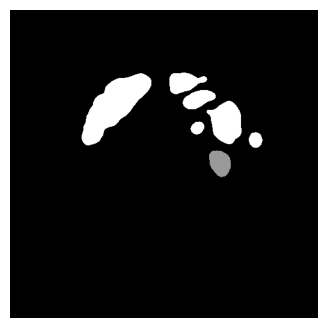

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0141.png


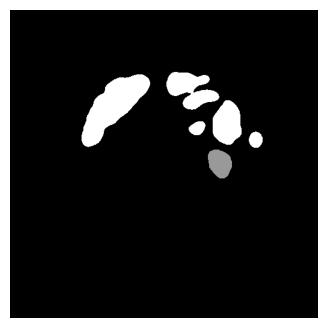

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0142.png


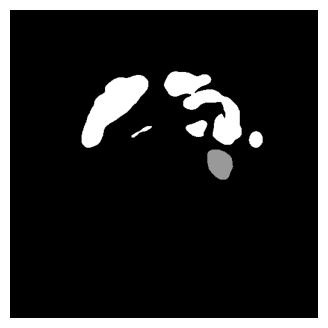

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0143.png


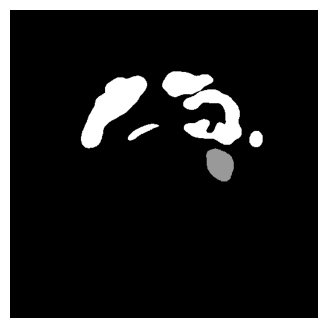

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0144.png


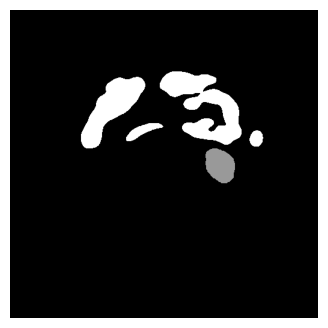

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0145.png


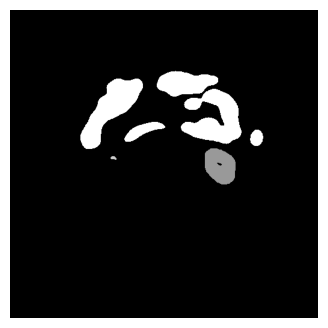

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0146.png


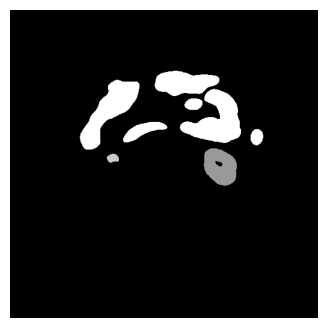

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0147.png


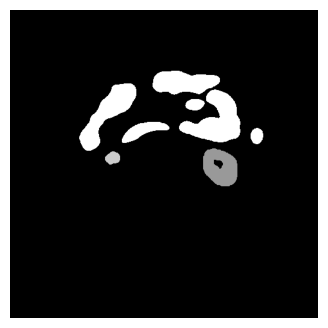

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0148.png


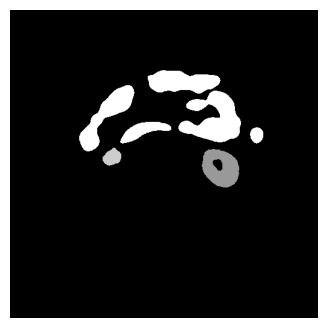

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0149.png


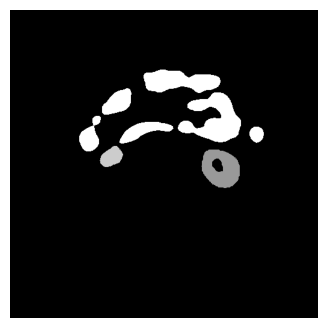

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0150.png


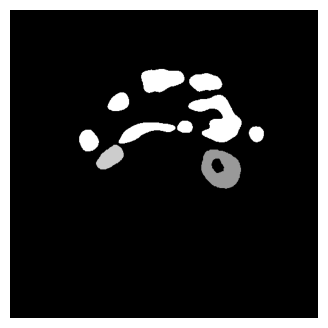

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0151.png


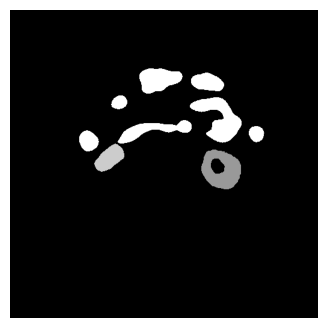

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0152.png


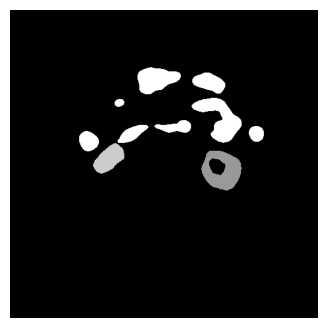

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0153.png


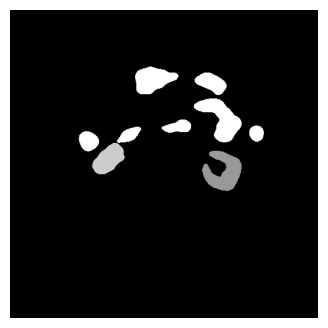

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0154.png


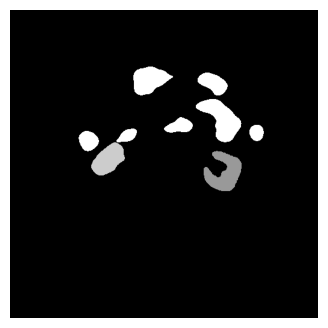

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0155.png


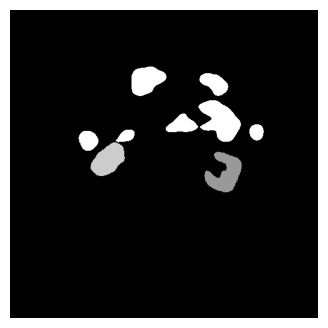

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0156.png


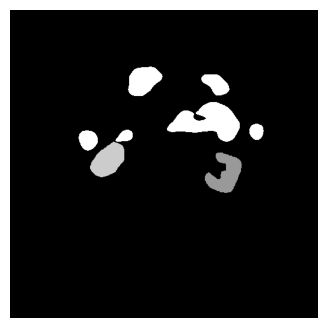

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0157.png


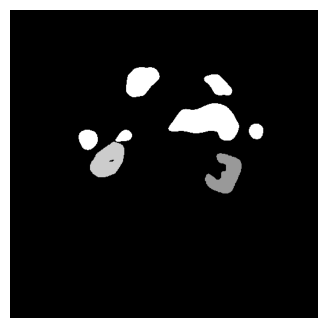

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0158.png


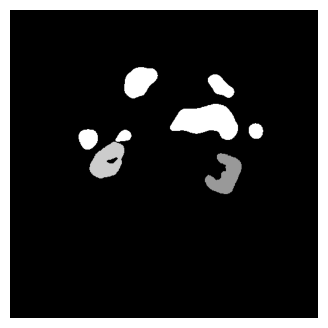

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0159.png


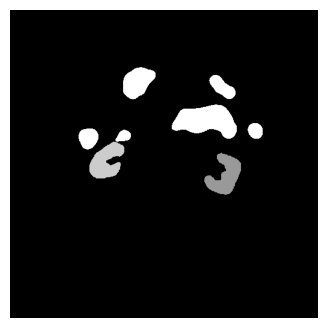

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0160.png


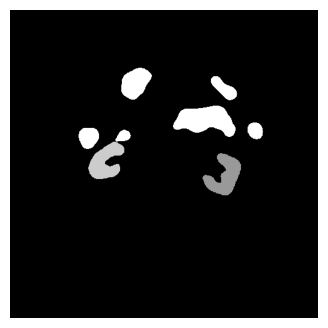

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0161.png


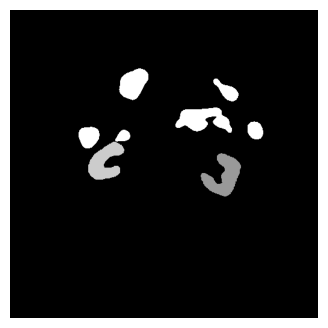

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0162.png


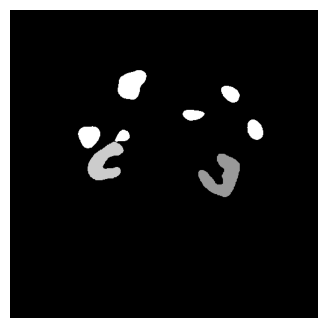

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0163.png


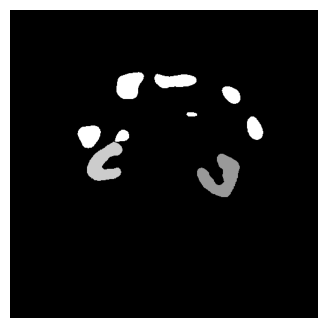

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0164.png


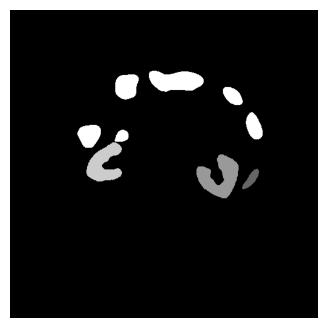

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0165.png


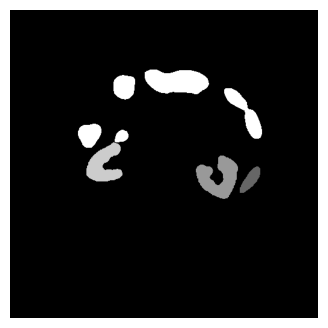

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0166.png


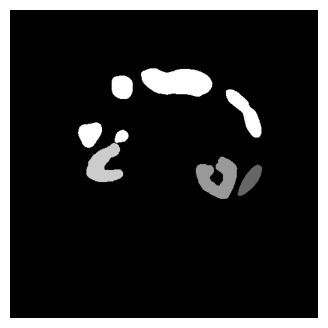

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0167.png


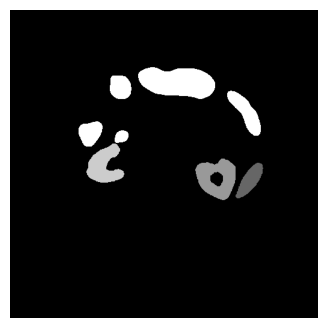

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0168.png


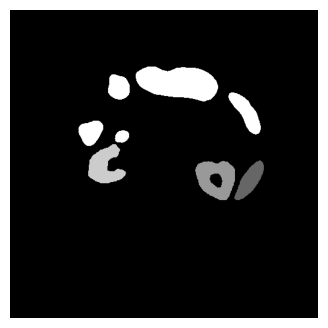

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0169.png


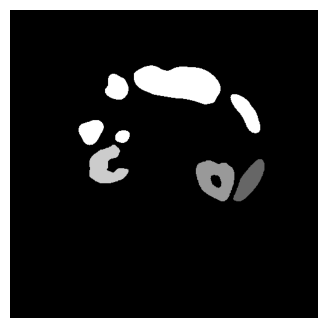

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0170.png


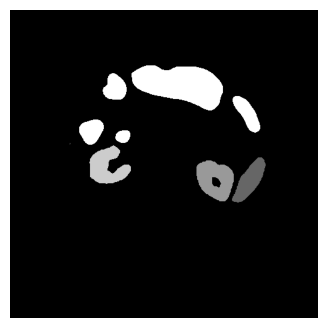

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0171.png


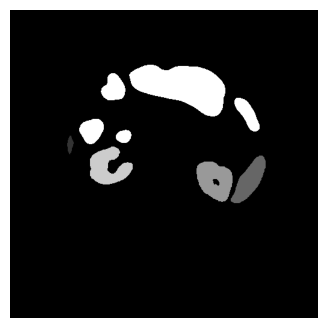

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0172.png


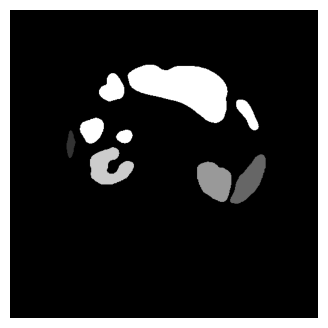

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0173.png


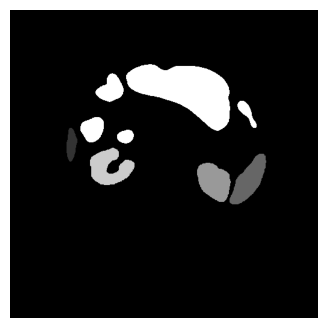

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0174.png


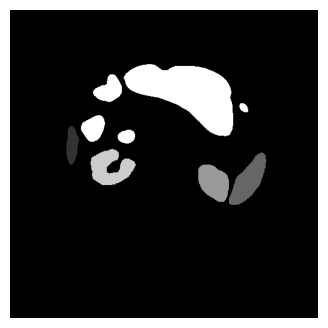

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0175.png


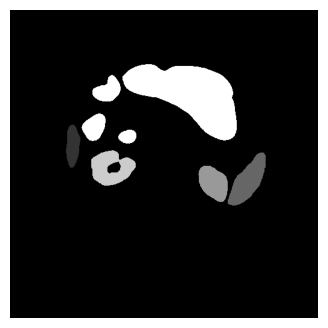

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0176.png


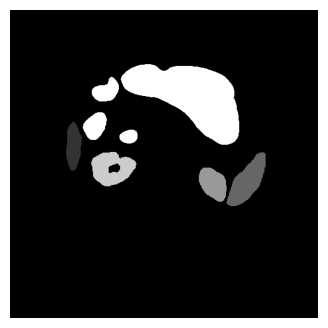

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0177.png


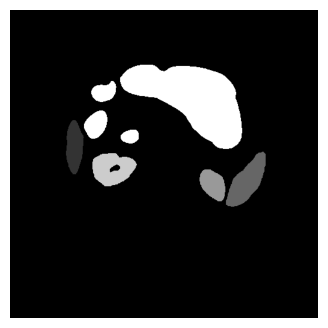

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0178.png


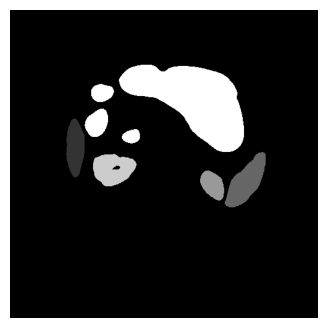

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0179.png


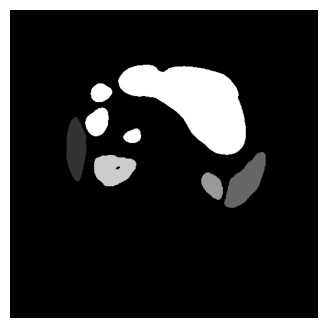

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0180.png


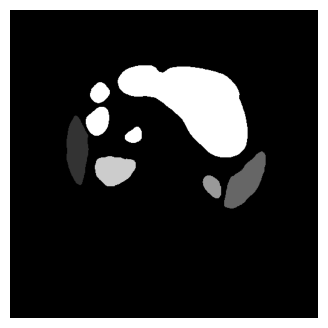

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0181.png


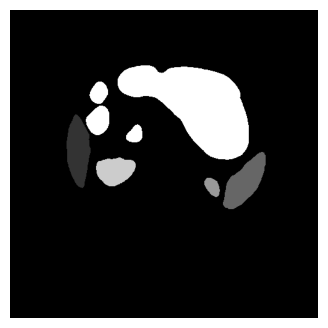

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0182.png


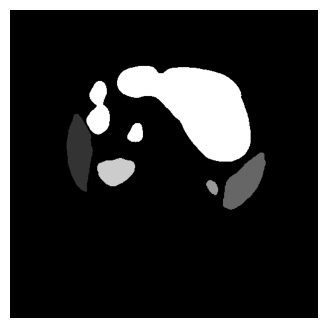

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0183.png


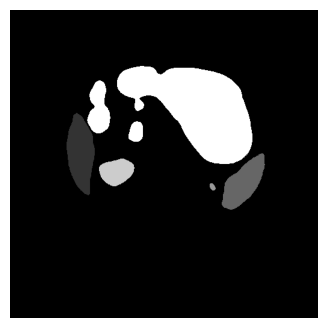

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0184.png


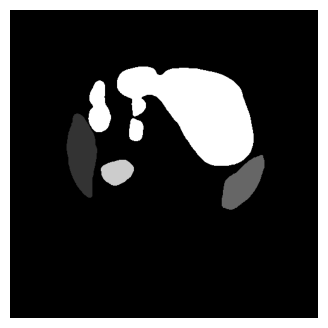

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0185.png


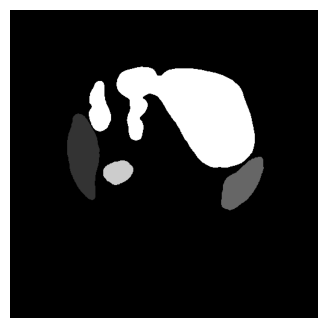

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0186.png


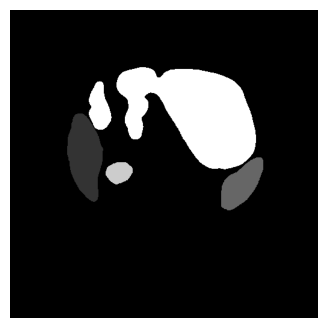

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0187.png


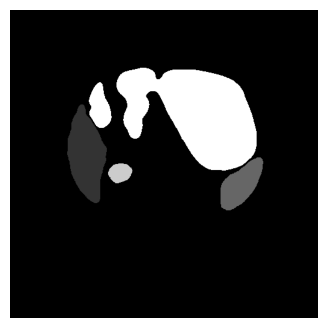

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0188.png


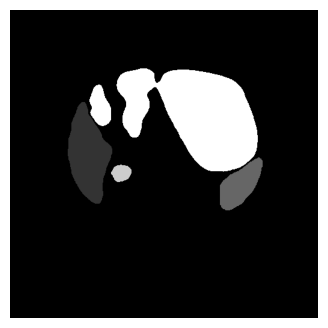

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0189.png


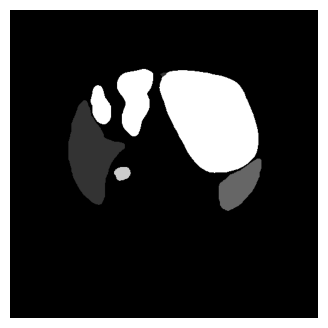

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0190.png


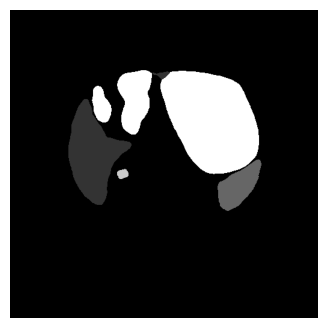

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0191.png


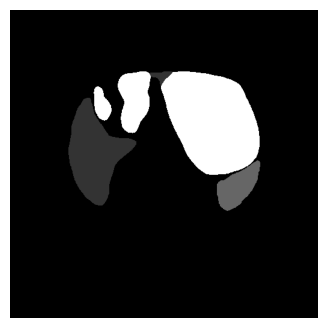

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0192.png


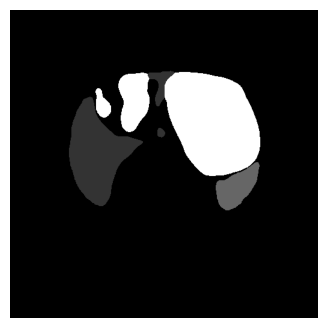

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0193.png


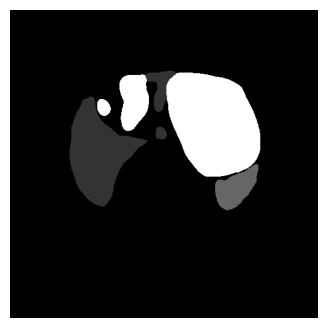

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0194.png


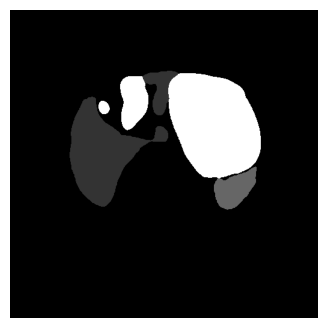

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0195.png


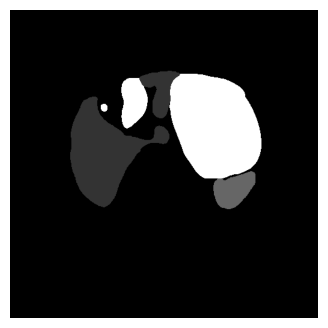

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0196.png


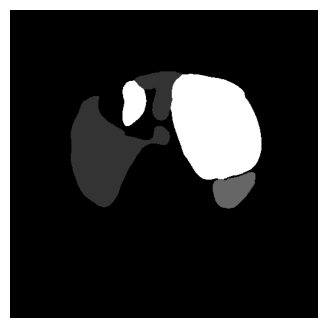

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0197.png


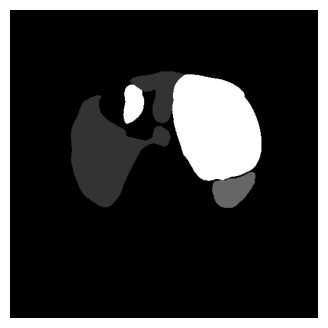

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0198.png


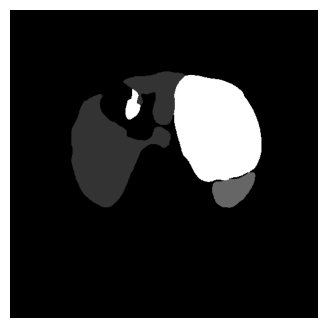

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0199.png


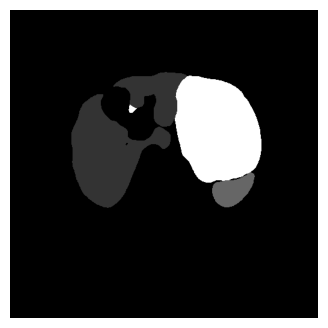

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0200.png


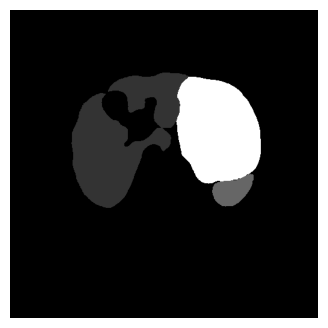

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0201.png


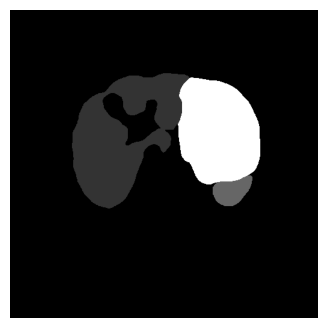

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0202.png


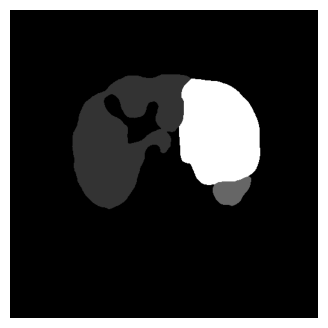

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0203.png


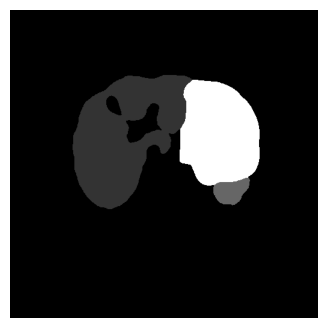

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0204.png


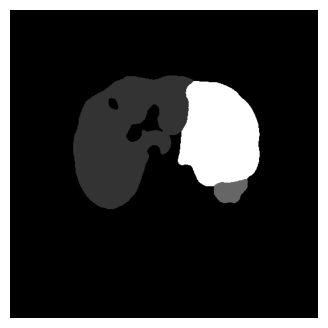

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0205.png


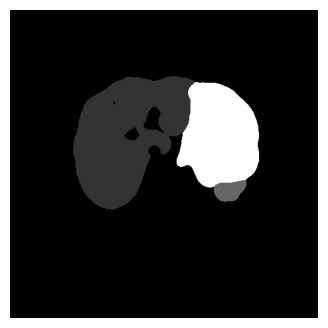

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0206.png


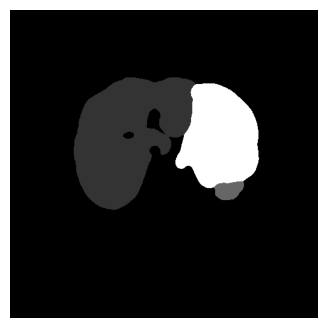

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0207.png


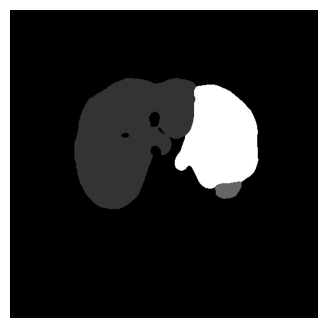

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0208.png


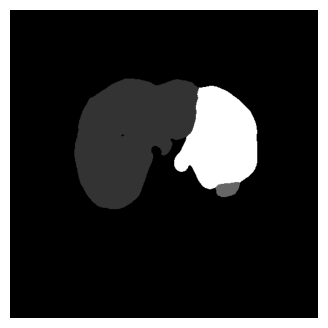

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0209.png


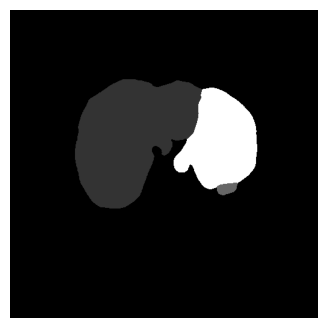

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0210.png


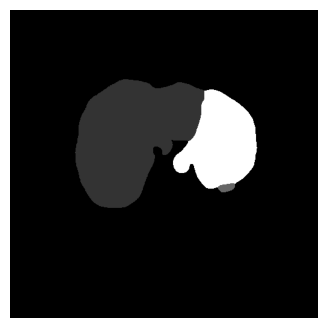

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0211.png


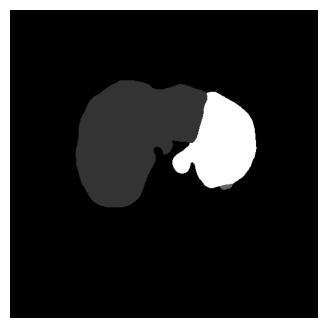

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0212.png


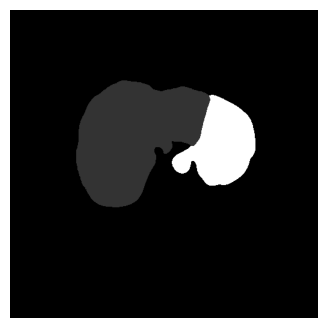

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0213.png


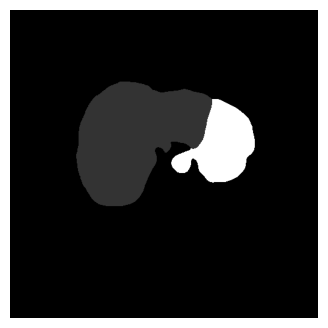

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0214.png


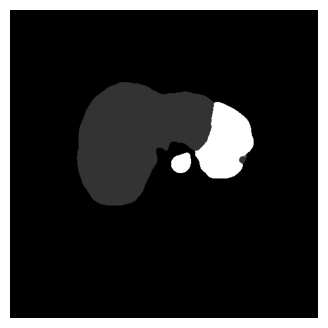

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0215.png


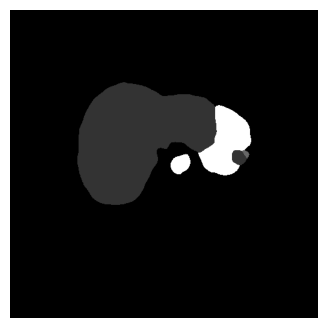

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0216.png


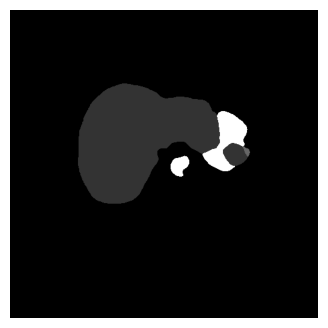

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0217.png


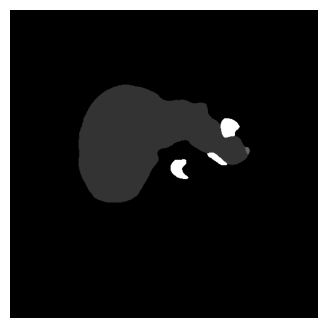

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0218.png


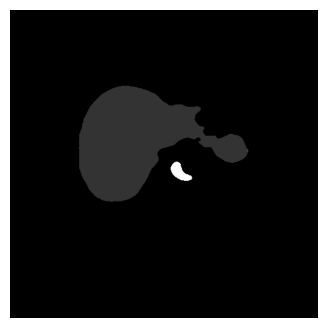

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0219.png


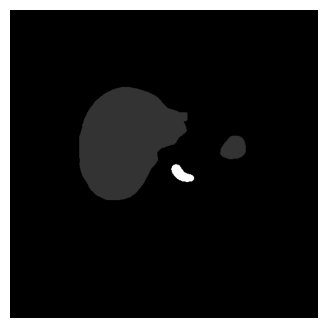

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0220.png


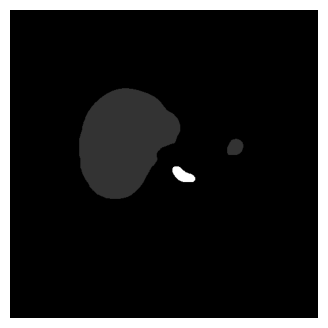

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0221.png


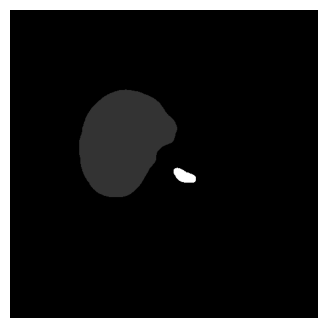

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0222.png


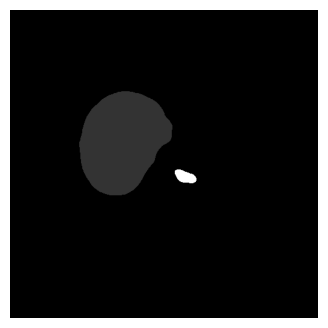

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0223.png


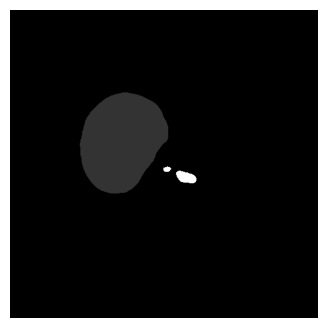

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0224.png


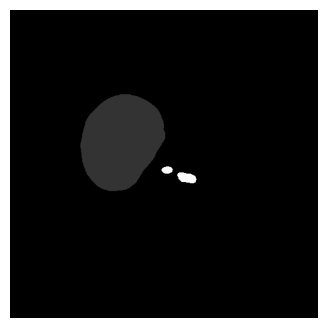

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0225.png


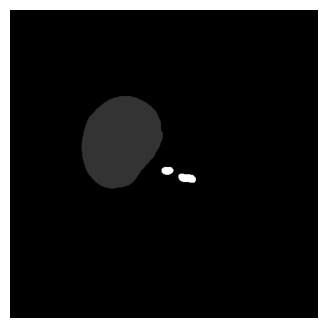

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0226.png


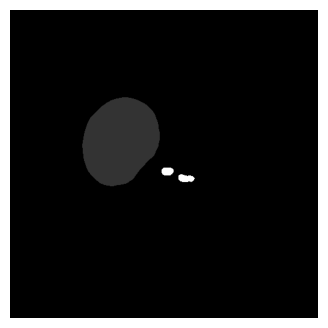

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0227.png


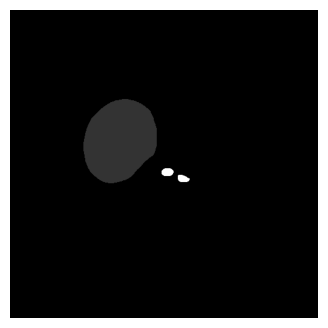

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0228.png


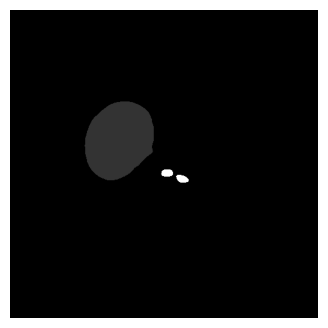

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0229.png


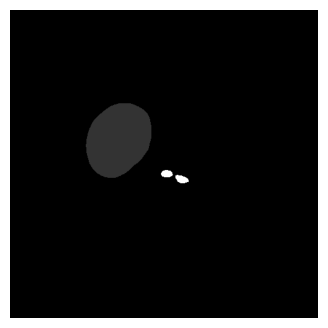

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0230.png


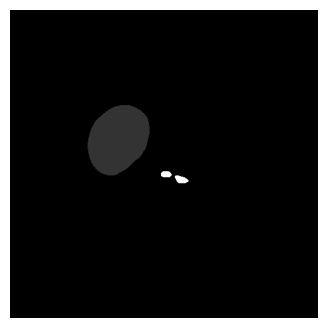

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0231.png


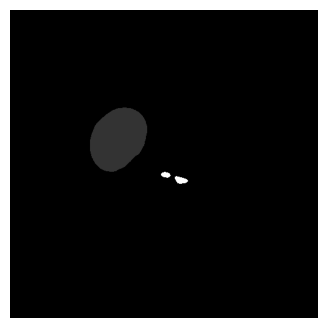

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0232.png


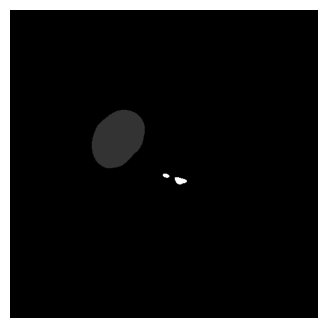

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0233.png


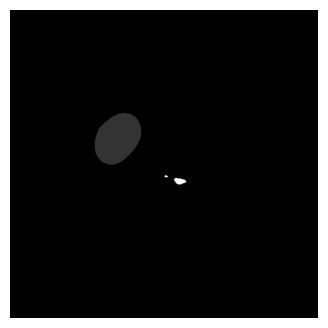

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0234.png


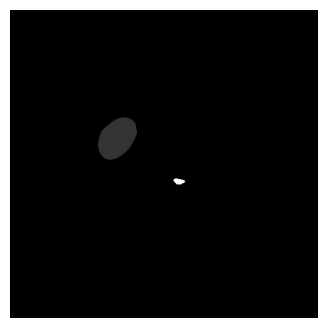

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0235.png


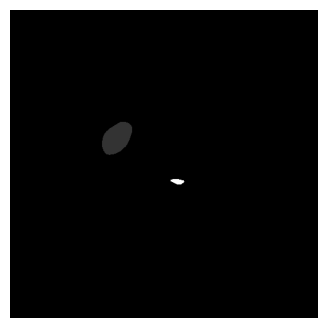

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0236.png


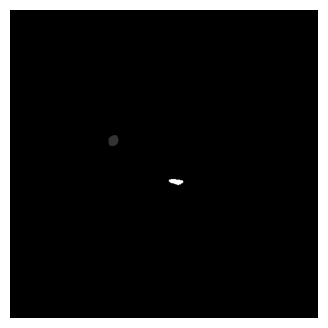

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0237.png


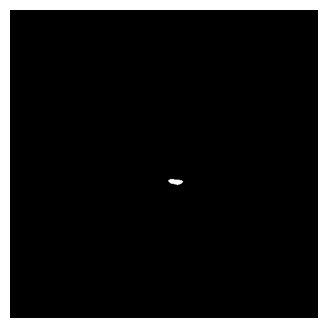

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0238.png


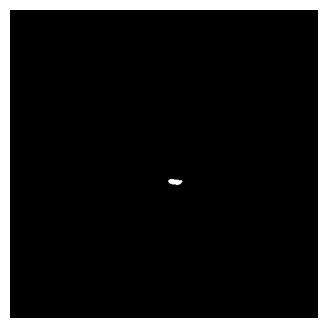

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0239.png


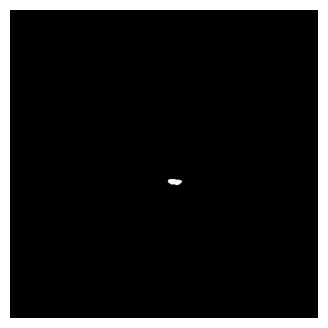

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0240.png


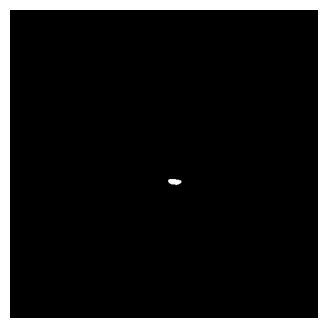

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0241.png


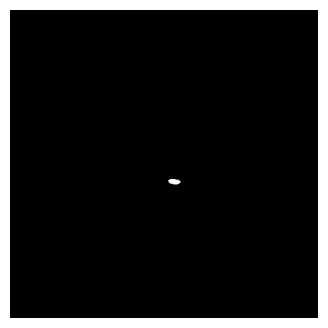

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0242.png


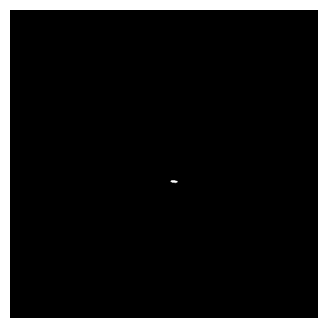

Saving: ../Outputs/Pre-processing/pngs\10494_seg_0243.png
Total slices processed: 214


In [44]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os

# Function to process and save slices from a NIfTI file
def process_nii_to_png(nii_path, output_dir, scale_factor=51):
    # Load the NIfTI image
    nii_img = nib.load(nii_path)
    data = nii_img.get_fdata()
    print(f"Shape of NIfTI data: {data.shape}")

    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    images = []
    
    for i in range(data.shape[2]):
        img = data[:, :, i] * scale_factor
        if img.max() > 0:
            img = np.rot90(img)  # Rotate the image
            
            # Display the image
            plt.figure(figsize=(4, 4))
            plt.imshow(img, cmap='gray')  # Using grayscale colormap
            plt.axis('off')
            plt.show()
            
            # Save the image as a PNG file
            newfile = os.path.join(output_dir, f'10494_seg_{str(i).zfill(4)}.png')
            print(f"Saving: {newfile}")
            cv2.imwrite(newfile, img)
            
            images.append(img)
    
    print(f"Total slices processed: {len(images)}")
    return images

# Example usage
nii_path = '../Data/segmentations/10494.nii'
output_dir = '../Outputs/Pre-processing/pngs'
images = process_nii_to_png(nii_path, output_dir)


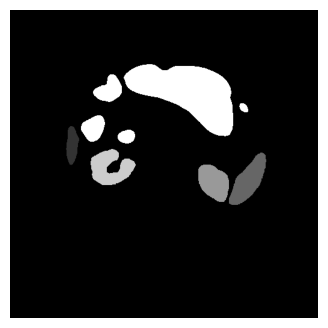

In [45]:
path0='../Outputs/Pre-processing/pngs/10494_seg_0175.png'

plt.figure(figsize=(4,4))
image3 = cv2.imread(path0)
plt.imshow(image3)
plt.axis('off')
plt.show()

In [38]:
path0

'../Outputs/Pre-processing/pngs/10494_seg_0175.png'

In [47]:
image = cv2.imread(path0, cv2.IMREAD_COLOR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
pixels = np.argwhere(hsv>0)
all_colors = {tuple(image[pixel[0], pixel[1]]) for pixel in pixels}
print("All colors:", all_colors)

All colors: {(51, 51, 51), (255, 255, 255), (102, 102, 102), (204, 204, 204), (153, 153, 153)}


bowel


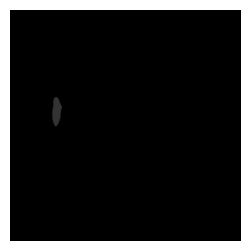

liver


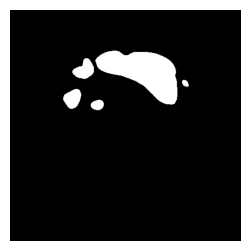

spleen


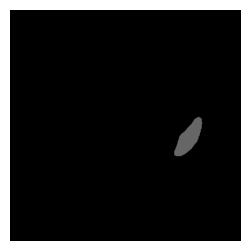

right kidney


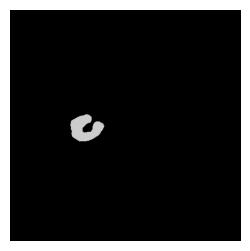

left kidney


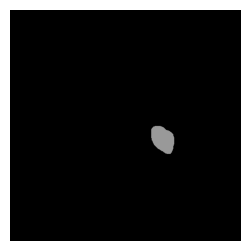

In [48]:
colors=[(51, 51, 51), (255, 255, 255), (102, 102, 102), (204, 204, 204), (153, 153, 153)]
organs=['bowel','liver','spleen','right kidney','left kidney']

for i,color in enumerate(colors):
    lower_color = color
    upper_color = color
    mask = cv2.inRange(image, lower_color, upper_color)
    focus = cv2.bitwise_and(image, image, mask=mask)
    print(organs[i])
    plt.figure(figsize=(3,3))
    plt.imshow(focus)
    plt.axis('off')
    plt.show()

In [76]:
import os
import cv2
import numpy as np

# Define the grayscale colors and corresponding organs
grayscale_colors = [(51, 51, 51), (255, 255, 255), (102, 102, 102), (204, 204, 204), (153, 153, 153)]
organs = ['bowel', 'liver', 'spleen', 'right kidney', 'left kidney']

# Define the RGB colors for each organ with comments specifying the organ names
rgb_colors = [
    (255, 0, 255),  # Magenta for bowel
    (255, 0, 0),    # Red for liver
    (0, 255, 0),    # Green for spleen
    (0, 255, 255),  # Cyan for right kidney
    (0, 0, 255)     # Blue for left kidney
]

# Define paths
png_image_dir = '../Outputs/Pre-processing/pngs/'
png_mask_dir = '../Outputs/Pre-processing/organs/'

# Ensure base directories exist
os.makedirs(png_image_dir, exist_ok=True)
os.makedirs(png_mask_dir, exist_ok=True)

# Ensure directories exist for each organ
for organ in organs:
    organ_dir = os.path.join(png_mask_dir, organ)
    os.makedirs(organ_dir, exist_ok=True)

def map_grayscale_to_rgb_and_save(image_path, grayscale_colors, rgb_colors, organs, png_mask_dir):
    # Load the grayscale image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    if image is None:
        print(f"Error: Could not read image at {image_path}")
        return
    
    # Create an empty RGB image
    rgb_image = np.zeros((*image.shape, 3), dtype=np.uint8)
    
    # Map grayscale values to RGB colors
    for i, gs_color in enumerate(grayscale_colors):
        # Create a mask for pixels within a tolerance range of the grayscale color
        mask = np.logical_and.reduce((image >= gs_color[0] - 5, image <= gs_color[0] + 5,
                                      image >= gs_color[1] - 5, image <= gs_color[1] + 5,
                                      image >= gs_color[2] - 5, image <= gs_color[2] + 5))
        # Apply the RGB color to the mask
        rgb_image[mask] = rgb_colors[i]
    
    # Save the colored mask in the respective organ directories
    saved = False  # Flag to check if any organ's mask has been saved
    
    for i, organ in enumerate(organs):
        organ_dir = os.path.join(png_mask_dir, organ)
        
        # Create a mask for the current organ and extract the masked region from the RGB image
        organ_mask = np.all(rgb_image == np.array(rgb_colors[i], dtype=np.uint8), axis=-1)
        if np.any(organ_mask):
            save_path = os.path.join(organ_dir, os.path.basename(image_path))
            print(f"Saving {organ}: {os.path.basename(image_path)}")
            
            organ_image = np.zeros_like(rgb_image, dtype=np.uint8)
            organ_image[organ_mask] = rgb_image[organ_mask]
            
            cv2.imwrite(save_path, cv2.cvtColor(organ_image, cv2.COLOR_RGB2BGR))
            saved = True
    
    # If no organ mask was saved, print a message
    if not saved:
        print(f"No organ mask saved for {os.path.basename(image_path)}.")

# Process each image in the png_image_dir
for file in os.listdir(png_image_dir):
    image_path = os.path.join(png_image_dir, file)
    map_grayscale_to_rgb_and_save(image_path, grayscale_colors, rgb_colors, organs, png_mask_dir)


Saving liver: 10494_seg_0030.png
Saving liver: 10494_seg_0031.png
Saving liver: 10494_seg_0032.png
Saving liver: 10494_seg_0033.png
Saving liver: 10494_seg_0034.png
Saving liver: 10494_seg_0035.png
Saving liver: 10494_seg_0036.png
Saving liver: 10494_seg_0037.png
Saving liver: 10494_seg_0038.png
Saving liver: 10494_seg_0039.png
Saving liver: 10494_seg_0040.png
Saving liver: 10494_seg_0041.png
Saving liver: 10494_seg_0042.png
Saving liver: 10494_seg_0043.png
Saving liver: 10494_seg_0044.png
Saving liver: 10494_seg_0045.png
Saving liver: 10494_seg_0046.png
Saving liver: 10494_seg_0047.png
Saving liver: 10494_seg_0048.png
Saving liver: 10494_seg_0049.png
Saving liver: 10494_seg_0050.png
Saving liver: 10494_seg_0051.png
Saving liver: 10494_seg_0052.png
Saving liver: 10494_seg_0053.png
Saving liver: 10494_seg_0054.png
Saving liver: 10494_seg_0055.png
Saving liver: 10494_seg_0056.png
Saving liver: 10494_seg_0057.png
Saving liver: 10494_seg_0058.png
Saving liver: 10494_seg_0059.png
Saving liv

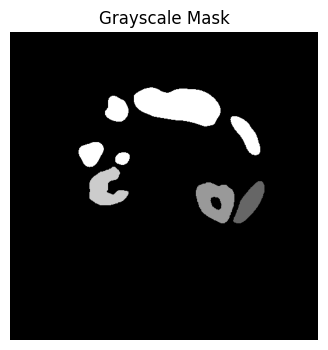

No mask found for bowel.


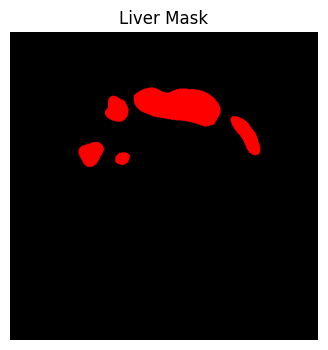

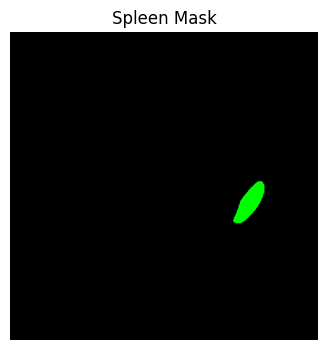

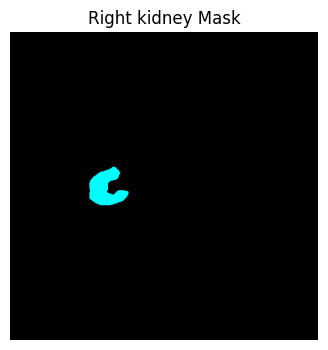

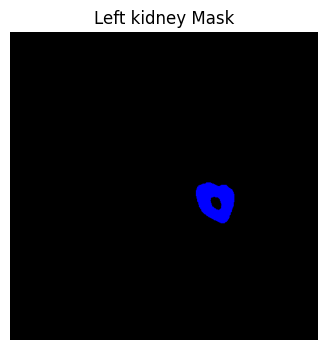

In [80]:
import os
import cv2
import matplotlib.pyplot as plt

# Define paths
png_image_dir = '../Outputs/Pre-processing/pngs/'
png_mask_dirs = [
    '../Outputs/Pre-processing/organs/bowel/',
    '../Outputs/Pre-processing/organs/liver/',
    '../Outputs/Pre-processing/organs/spleen/',
    '../Outputs/Pre-processing/organs/right kidney/',
    '../Outputs/Pre-processing/organs/left kidney/'
]

# Load and display the original image
image_path = os.path.join(png_image_dir, '10494_seg_0170.png')
original_image = cv2.imread(image_path)
original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

plt.figure(figsize=(4, 4))
plt.imshow(original_image)
plt.title('Grayscale Mask')
plt.axis('off')
plt.show()

# Display masks for each organ
for organ_dir in png_mask_dirs:
    organ_name = os.path.basename(os.path.normpath(organ_dir))
    organ_mask_path = os.path.join(organ_dir, '10494_seg_0170.png')
    
    if os.path.exists(organ_mask_path):
        organ_mask = cv2.imread(organ_mask_path)
        organ_mask = cv2.cvtColor(organ_mask, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
        
        plt.figure(figsize=(4, 4))
        plt.imshow(organ_mask)
        plt.title(f'{organ_name.capitalize()} Mask')
        plt.axis('off')
        plt.show()
    else:
        print(f"No mask found for {organ_name}.")


# EXperiment 

## Converting .nii to RGB color masks into png format and saving annoattion respectively

In [95]:
# import nibabel as nib
# import numpy as np
# import cv2
# import os

# # Define the grayscale colors and corresponding organs
# grayscale_colors = [(51, 51, 51), (255, 255, 255), (102, 102, 102), (204, 204, 204), (153, 153, 153)]
# organs = ['bowel', 'liver', 'spleen', 'right kidney', 'left kidney']

# # Define the RGB colors for each organ
# rgb_colors = [
#     (255, 0, 255),  # Magenta for bowel
#     (255, 0, 0),    # Red for liver
#     (0, 255, 0),    # Green for spleen
#     (0, 255, 255),  # Cyan for right kidney
#     (0, 0, 255)     # Blue for left kidney
# ]

# # Function to process and save slices from a NIfTI file
# def process_nii_to_png(nii_path, output_dir, annotation_dir, scale_factor=51):
#     # Load the NIfTI image
#     nii_img = nib.load(nii_path)
#     data = nii_img.get_fdata()
#     print(f"Shape of NIfTI data: {data.shape}")

#     # Ensure the output directory exists
#     os.makedirs(output_dir, exist_ok=True)
#     os.makedirs(annotation_dir, exist_ok=True)

#     images = []
    
#     for i in range(data.shape[2]):
#         img = data[:, :, i] * scale_factor
#         if img.max() > 0:
#             img = np.rot90(img)  # Rotate the image
            
#             # Initialize a blank color image
#             color_img = np.zeros((*img.shape, 3), dtype=np.uint8)
            
#             bboxes = []

#             for idx, (grayscale, rgb) in enumerate(zip(grayscale_colors, rgb_colors)):
#                 mask = img == grayscale[0]
#                 color_img[mask] = rgb

#                 # Find contours and create bounding boxes
#                 contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#                 for contour in contours:
#                     x, y, w, h = cv2.boundingRect(contour)
#                     bboxes.append((organs[idx], x, y, w, h))  # Store organ name instead of index
            
#             # Save the image as a PNG file
#             newfile = os.path.join(output_dir, f'10494_seg_{str(i).zfill(4)}.png')
#             print(f"Saving: {newfile}")
#             cv2.imwrite(newfile, cv2.cvtColor(color_img, cv2.COLOR_RGB2BGR))
            
#             # Save the bounding boxes in YOLO format
#             annotation_file = os.path.join(annotation_dir, f'10494_seg_{str(i).zfill(4)}.txt')
#             with open(annotation_file, 'w') as f:
#                 for bbox in bboxes:
#                     organ, x, y, w, h = bbox
#                     x_center = (x + w / 2) / img.shape[1]
#                     y_center = (y + h / 2) / img.shape[0]
#                     width = w / img.shape[1]
#                     height = h / img.shape[0]
#                     f.write(f"{organs.index(organ)} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            
#             images.append(color_img)
    
#     print(f"Total slices processed: {len(images)}")
#     return images

# # Example usage
# # nii_path = '../Data/segmentations/10494.nii'

# import os
# import random

# # Directory containing the NIfTI files
# nii_dir = '../Data/segmentations/'

# # List all files in the directory
# nii_files = os.listdir(nii_dir)

# # Filter only files ending with .nii
# nii_files = [file for file in nii_files if file.endswith('.nii')]

# # Choose 10 random files
# random.seed(42)  # For reproducibility
# random_nii_files = random.sample(nii_files, 10)

# # Print the selected files
# for nii_file in random_nii_files:
#     nii_path = os.path.join(nii_dir, nii_file)
#     print(nii_path)

# output_dir = '../Outputs/Pre-processing/pngs_color'
# annotation_dir = '../Outputs/Pre-processing/annotations'
# images = process_nii_to_png(nii_path, output_dir, annotation_dir)
# output_dir = '../Outputs/Pre-processing/pngs_color'
# annotation_dir = '../Outputs/Pre-processing/annotations'
# images = process_nii_to_png(nii_path, output_dir, annotation_dir)


## visulaising some images

In [97]:
# import cv2
# import os

# # Define the grayscale colors and corresponding organs
# grayscale_colors = [(51, 51, 51), (255, 255, 255), (102, 102, 102), (204, 204, 204), (153, 153, 153)]
# organs = ['bowel', 'liver', 'spleen', 'right kidney', 'left kidney']

# # Define the RGB colors for each organ
# rgb_colors = [
#     (255, 0, 255),  # Magenta for bowel
#     (255, 0, 0),    # Red for liver
#     (0, 255, 0),    # Green for spleen
#     (0, 255, 255),  # Cyan for right kidney
#     (0, 0, 255)     # Blue for left kidney
# ]

# # Function to visualize bounding boxes on a single image
# def visualize_single_image(image_path, annotation_path, output_dir):
#     # Ensure the output directory exists
#     os.makedirs(output_dir, exist_ok=True)

#     # Read the image
#     image = cv2.imread(image_path)
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#     # Read annotation file and draw bounding boxes
#     with open(annotation_path, 'r') as f:
#         lines = f.readlines()
#         for line in lines:
#             class_index, x_center, y_center, width, height = map(float, line.split())
            
#             # Convert YOLO format to bounding box coordinates
#             image_height, image_width, _ = image.shape
#             x_center = int(x_center * image_width)
#             y_center = int(y_center * image_height)
#             w = int(width * image_width)
#             h = int(height * image_height)
#             x = int(x_center - w / 2)
#             y = int(y_center - h / 2)
            
#             # Draw bounding box and label
#             class_index = int(class_index)
#             color = rgb_colors[class_index]
#             label = organs[class_index]
#             cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
#             cv2.putText(image, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    
#     # Save the annotated image
#     output_file = os.path.join(output_dir, os.path.basename(image_path).replace('.png', '_annotated.png'))
#     cv2.imwrite(output_file, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
#     print(f"Saved: {output_file}")

# # Example usage
# image_path = '../Outputs/Pre-processing/pngs_color/10494_seg_0158.png'
# annotation_path = '../Outputs/Pre-processing/annotations/10494_seg_0158.txt'
# output_dir = '../Outputs/Pre-processing/visualized_annotations'

# visualize_single_image(image_path, annotation_path, output_dir)


In [135]:
label_df = pd.read_csv(csv_file)
label_df.head()

,patient_id,series_id,aortic_hu,incomplete_organ,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,21057,146.00,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10004,51033,454.75,0,1,0,0,1,0,1,0,1,0,0,0,0,1,1
2,10005,18667,187.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10007,47578,329.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10026,29700,327.00,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [136]:
label_df['series_id'].nunique()

4711

In [138]:
label_df.size

84798